# **Setup**


In [1]:
!pip install pydicom

     |████████████████████████████████| 35.5MB 113kB/s 


In [2]:
import pydicom as pdm
import skimage as sk
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import os
import cv2

from skimage.transform import resize
from skimage.io import imread
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')
# drive.flush_and_unmount()
os.chdir("/content/gdrive/My Drive/Colab Notebooks/data")
os.getcwd()

Mounted at /content/gdrive


'/content/gdrive/My Drive/Colab Notebooks/data'

# **Part 1: Working with image files**
*   Load DICOM or PNG file.
*   Resize the image to user-specified dimensions (e.g. 229 x 229).
*   Write the resized image to numpy .npy files.
*   Combine the .npy files with breast density information. Store this into numpyz .npz files.



In [17]:
def resize_image(filepath, custom_shape, verbose=False):
  assert os.path.exists(filepath), "ERROR: file " + filepath + " not found!"

  if filepath.endswith(".png"):
    png_ndarray = imread(filepath)
    print_msg("Resizing PNG file...", verbose)
    png_resized = resize(image=png_ndarray, output_shape=custom_shape, anti_aliasing=False)
    print_msg("Success.", verbose)
    return (png_ndarray, png_resized)

  else:
    print_msg("Reading DICOM file...", verbose)
    dicom_dataset = pdm.dcmread(fp=filepath, defer_size=None, force=True)
    if not filepath.endswith("dcm"):
      print_msg("Decompressing DICOM file...", verbose)
      dicom_dataset = dicom_dataset.decompress()
    dicom_ndarray = dicom_dataset.pixel_array
    plt.imshow(dicom_ndarray, cmap=plt.cm.gray)
    plt.show()
    print_msg("Success.", verbose)

    print_msg("Resizing DICOM file...", verbose)
    dicom_resized = resize(image=dicom_ndarray, output_shape=custom_shape, anti_aliasing=False)
    print_msg("Success.", verbose) 
    plt.imshow(dicom_resized, cmap=plt.cm.gray)
    plt.show()

    # dicom_dataset.PixelData = dicom_resized
    # dicom_dataset.save_as(filepath + "resized.dcm")

    return (dicom_dataset, dicom_resized)

In [5]:
def save_to_npy(save_to, arr_data, verbose=False):
  npy_path = save_to + ".npy"
  np.save(npy_path, arr_data)
  print_msg("Success.", verbose)

  return npy_path

In [6]:
def save_to_npz(save_to, read_from, breast_density, verbose=False):
  print_msg("Loading npy file " + read_from + "...", verbose)
  resized_arr = np.load(file=read_from, allow_pickle=False)
  num_rows, num_cols = resized_arr.shape
  print_msg("Success.", verbose)

  print_msg("Creating new data with breast_density ...", verbose)
  new_arr = np.zeros((num_rows + 1, num_cols))
  for i in range(num_rows):
    new_arr[i] = resized_arr[i,:]
  new_arr[num_rows] = np.full(shape=(num_cols,), fill_value=breast_density)
  print_msg("Success.", verbose)

  npz_path = save_to + ".npz"
  print_msg("Saving to npz file " + npz_path + "...", verbose)
  np.savez(npz_path, new_arr)
  print_msg("Success.", verbose)

  return npz_path

In [7]:
def get_patient_id(filepath):
  i = filepath.index("P_") + 2
  patient_id = "P_"
  while filepath[i].isnumeric():
    patient_id += filepath[i]
    i += 1
  print("patient id is " + patient_id)
  return patient_id

In [8]:
def get_breast_density(df, patient_id):
  breast_density = df.loc[patient_id, "breast_density"]
  if breast_density.size > 1:
    breast_density = breast_density[0]
  return breast_density

In [9]:
def get_image_files(dir_path):
  print("getting image files...")
  train_files = {}
  test_files = {}
  for root, dirs, files in os.walk(dir_path):
    if files and files[0].endswith(".dcm"):
      if "Training" in root:
        train_files[root] = files[0]
      elif "Test" in root:
        test_files[root] = files[0]
  print("done getting image files!")
  return (train_files, test_files)

In [10]:
def get_scan_type(filepath):
  scan_type = "LEFT_" if "LEFT_" in filepath else "RIGHT_"
  scan_type += "CC" if "CC" in filepath else "MLO"
  return scan_type

In [11]:
def print_msg(msg, verbose):
  if verbose:
    print(msg)

In [12]:
def sort_npy_npz_files(dir):
  npy_dir = os.path.join(dir, "npy files")
  if not os.path.exists(npy_dir):
    os.mkdir(npy_dir)
  npz_dir = os.path.join(dir, "npz files")
  if not os.path.exists(npz_dir):
    os.mkdir(npz_dir)
  for f in os.listdir(dir):
    if f.endswith(".npy"):
      os.rename(os.path.join(dir, f), os.path.join(dir, npy_dir, f))
    elif f.endswith(".npz"):
      os.rename(os.path.join(dir, f), os.path.join(dir, npz_dir, f))

In [15]:
def main_helper(files_dict, df, resize_shape=(229, 229), save=True, verbose=False):
  
  data = []
  labels = []
  # resize_dir = os.path.join(os.getcwd(), "resized images")

  for fpath in files_dict:
    patient_id = get_patient_id(fpath)
    scan_type = get_scan_type(fpath)
    breast_density = get_breast_density(df, patient_id)
    image_fp = files_dict[fpath]

    dataset, resized_ndarray = resize_image(filepath=os.path.join(fpath, image_fp), custom_shape=resize_shape, verbose=verbose)
    # if save:
    #   if not os.path.exists(resize_dir):
    #     os.mkdir(resize_dir)
    #   output_path = os.path.join(resize_dir, patient_id + "_" + scan_type + "_" + image_fp)
    #   print_msg("Saving resized image to " + output_path, verbose)
    #   if image_fp.endswith("PNG"):
    #     plt.imsave(output_path, resized_ndarray)
    #   else:
    #     # new_ds = pdm.dataset.Dataset(dataset)
    #     dataset.save_as(output_path)
    #   print_msg("Success.", verbose)
    np_path = os.path.join(os.getcwd(), patient_id + "_" + scan_type)
    npy_path = save_to_npy(save_to=np_path, arr_data=resized_ndarray, verbose=verbose)
    npz_path = save_to_npz(save_to=np_path, read_from=npy_path, breast_density=breast_density)
    sort_npy_npz_files(os.getcwd())

    data.append(resized_ndarray)
    labels.append(0 if breast_density <= 2 else 1) # not dense for 1, 2 ; dense for 3, 4

  return (data, labels)

In [13]:
def main(dir_path, resize_shape=(229, 229), save=True, verbose=False):
  train_csv = os.path.join(os.getcwd(), "mass_case_description_train_set.csv")
  test_csv = os.path.join(os.getcwd(), "mass_case_description_test_set.csv")
  train_df = pd.read_csv(train_csv, index_col="patient_id")
  test_df = pd.read_csv(test_csv, index_col="patient_id")

  train_files, test_files = get_image_files(dir_path)

  train_data, train_labels = main_helper(train_files, train_df, resize_shape, save, verbose)
  test_data, test_labels = main_helper(test_files, test_df, resize_shape, save, verbose)
  return (train_data, train_labels, test_data, test_labels)

# **Testing**

getting image files...
done getting image files!
patient id is P_00229
Reading DICOM file...


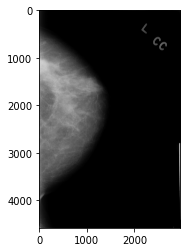

Success.
Resizing DICOM file...
Success.


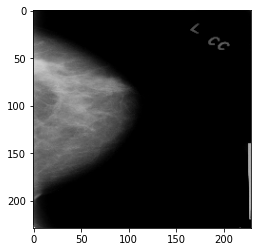

Success.
patient id is P_00058
Reading DICOM file...


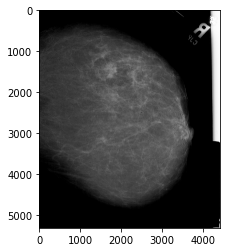

Success.
Resizing DICOM file...
Success.


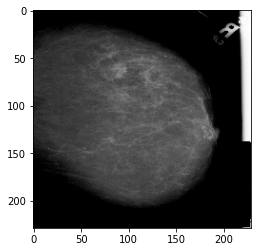

Success.
patient id is P_00187
Reading DICOM file...


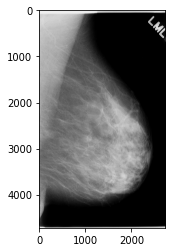

Success.
Resizing DICOM file...
Success.


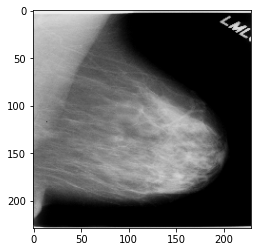

Success.
patient id is P_00304
Reading DICOM file...


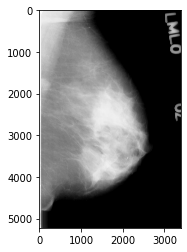

Success.
Resizing DICOM file...
Success.


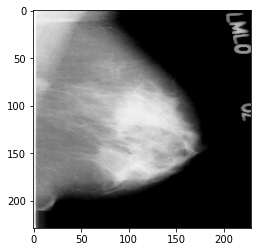

Success.
patient id is P_00247
Reading DICOM file...


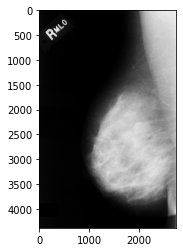

Success.
Resizing DICOM file...
Success.


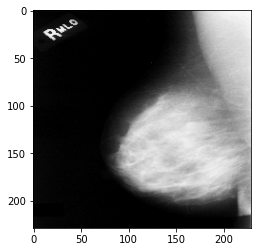

Success.
patient id is P_00045
Reading DICOM file...


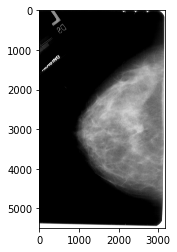

Success.
Resizing DICOM file...
Success.


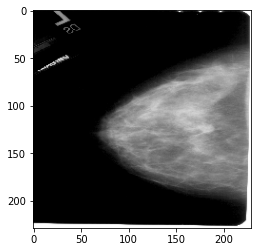

Success.
patient id is P_00160
Reading DICOM file...


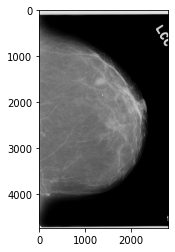

Success.
Resizing DICOM file...
Success.


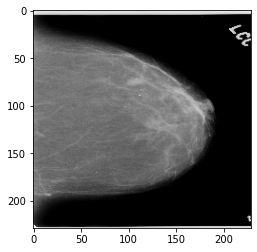

Success.
patient id is P_00055
Reading DICOM file...


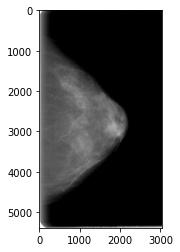

Success.
Resizing DICOM file...
Success.


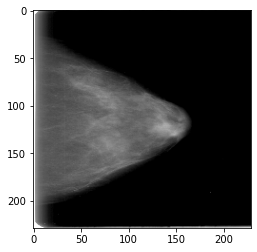

Success.
patient id is P_00351
Reading DICOM file...


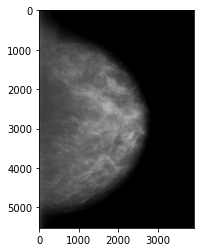

Success.
Resizing DICOM file...
Success.


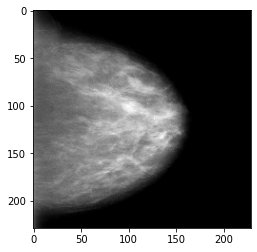

Success.
patient id is P_00044
Reading DICOM file...


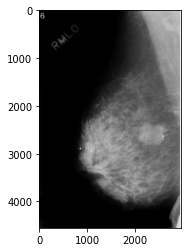

Success.
Resizing DICOM file...
Success.


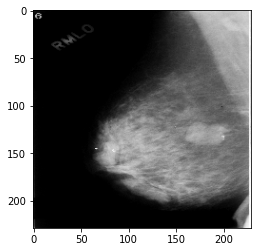

Success.
patient id is P_00068
Reading DICOM file...


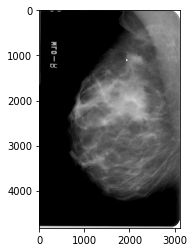

Success.
Resizing DICOM file...
Success.


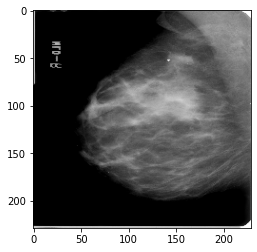

Success.
patient id is P_00330
Reading DICOM file...


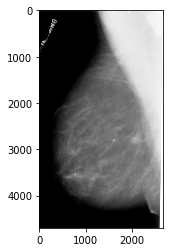

Success.
Resizing DICOM file...
Success.


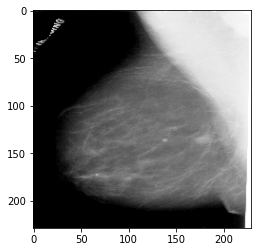

Success.
patient id is P_00376
Reading DICOM file...


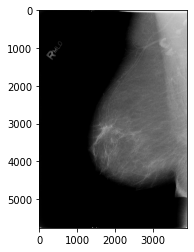

Success.
Resizing DICOM file...
Success.


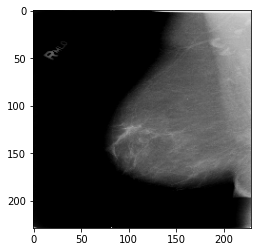

Success.
patient id is P_00224
Reading DICOM file...


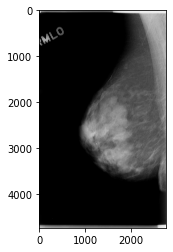

Success.
Resizing DICOM file...
Success.


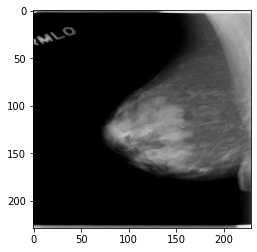

Success.
patient id is P_00242
Reading DICOM file...


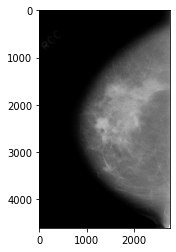

Success.
Resizing DICOM file...
Success.


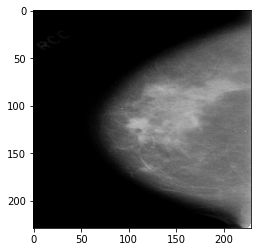

Success.
patient id is P_00396
Reading DICOM file...


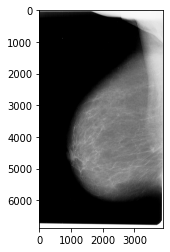

Success.
Resizing DICOM file...
Success.


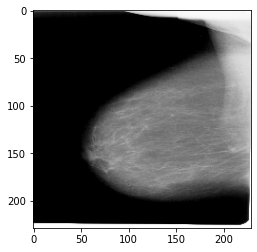

Success.
patient id is P_00134
Reading DICOM file...


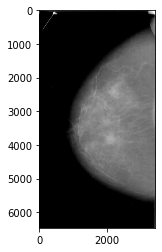

Success.
Resizing DICOM file...
Success.


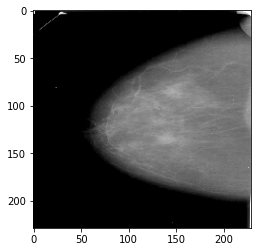

Success.
patient id is P_00208
Reading DICOM file...


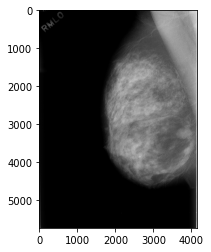

Success.
Resizing DICOM file...
Success.


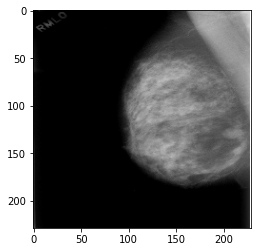

Success.
patient id is P_00264
Reading DICOM file...


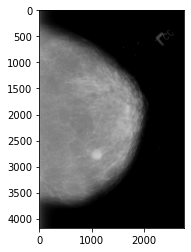

Success.
Resizing DICOM file...
Success.


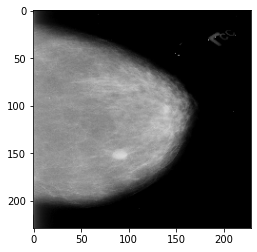

Success.
patient id is P_00348
Reading DICOM file...


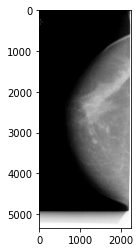

Success.
Resizing DICOM file...
Success.


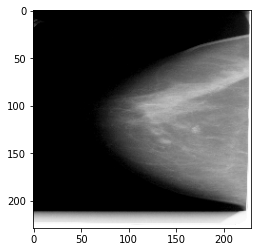

Success.
patient id is P_00303
Reading DICOM file...


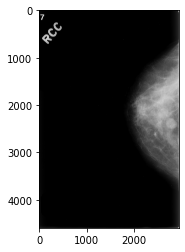

Success.
Resizing DICOM file...
Success.


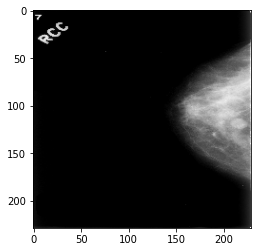

Success.
patient id is P_00027
Reading DICOM file...


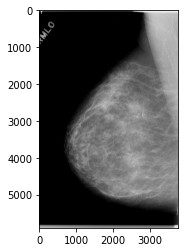

Success.
Resizing DICOM file...
Success.


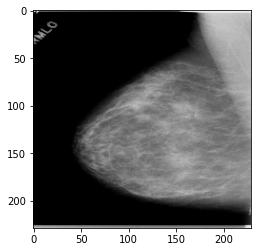

Success.
patient id is P_00080
Reading DICOM file...


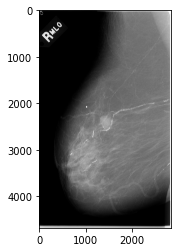

Success.
Resizing DICOM file...
Success.


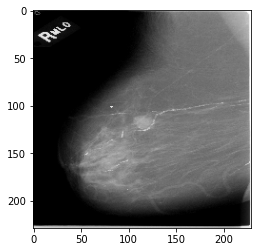

Success.
patient id is P_00094
Reading DICOM file...


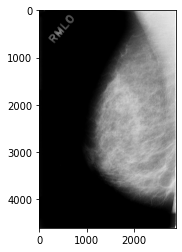

Success.
Resizing DICOM file...
Success.


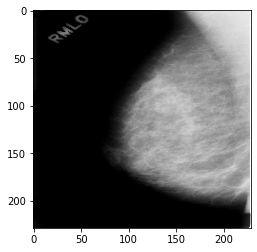

Success.
patient id is P_00289
Reading DICOM file...


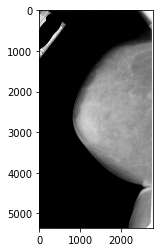

Success.
Resizing DICOM file...
Success.


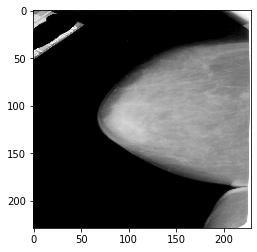

Success.
patient id is P_00235
Reading DICOM file...


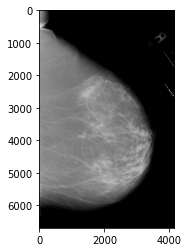

Success.
Resizing DICOM file...
Success.


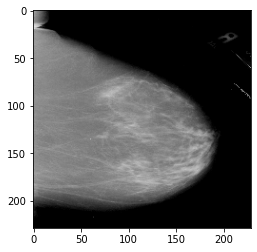

Success.
patient id is P_00283
Reading DICOM file...


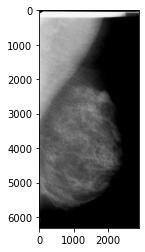

Success.
Resizing DICOM file...
Success.


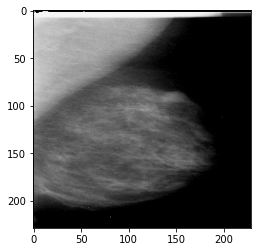

Success.
patient id is P_00294
Reading DICOM file...


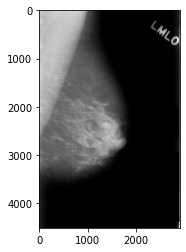

Success.
Resizing DICOM file...
Success.


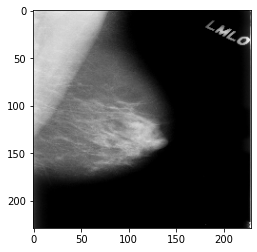

Success.
patient id is P_00207
Reading DICOM file...


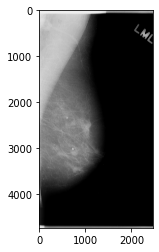

Success.
Resizing DICOM file...
Success.


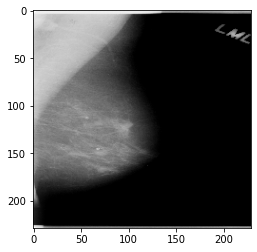

Success.
patient id is P_00120
Reading DICOM file...


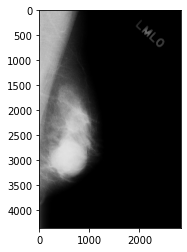

Success.
Resizing DICOM file...
Success.


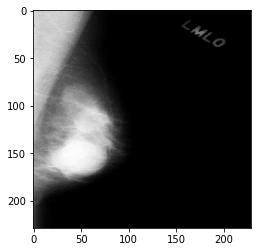

Success.
patient id is P_00224
Reading DICOM file...


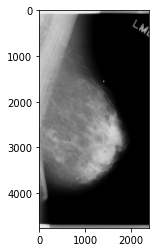

Success.
Resizing DICOM file...
Success.


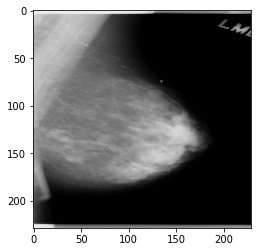

Success.
patient id is P_00231
Reading DICOM file...


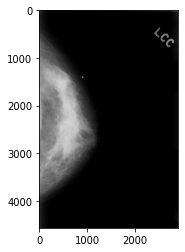

Success.
Resizing DICOM file...
Success.


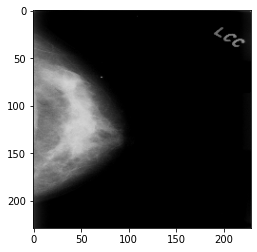

Success.
patient id is P_00205
Reading DICOM file...


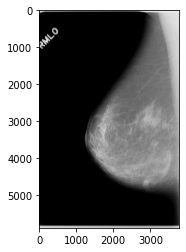

Success.
Resizing DICOM file...
Success.


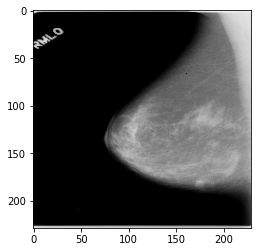

Success.
patient id is P_00313
Reading DICOM file...


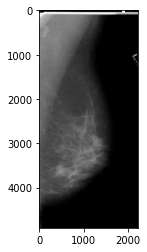

Success.
Resizing DICOM file...
Success.


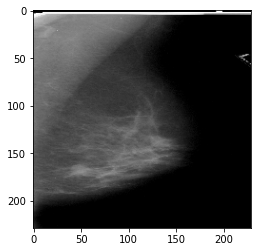

Success.
patient id is P_00298
Reading DICOM file...


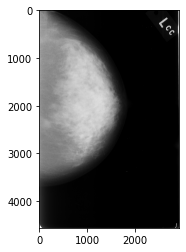

Success.
Resizing DICOM file...
Success.


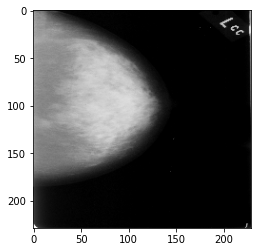

Success.
patient id is P_00190
Reading DICOM file...


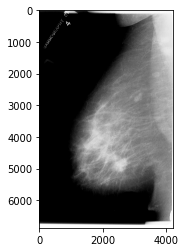

Success.
Resizing DICOM file...
Success.


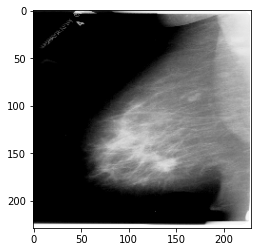

Success.
patient id is P_00332
Reading DICOM file...


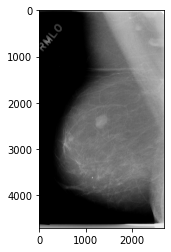

Success.
Resizing DICOM file...
Success.


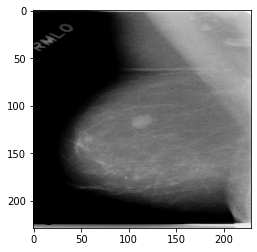

Success.
patient id is P_00001
Reading DICOM file...


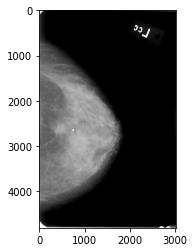

Success.
Resizing DICOM file...
Success.


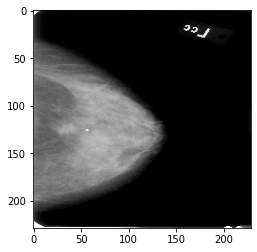

Success.
patient id is P_00039
Reading DICOM file...


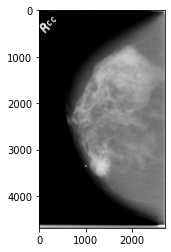

Success.
Resizing DICOM file...
Success.


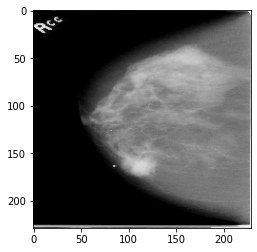

Success.
patient id is P_00175
Reading DICOM file...


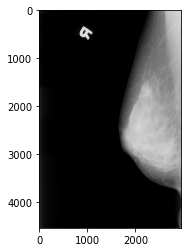

Success.
Resizing DICOM file...
Success.


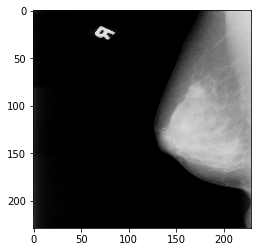

Success.
patient id is P_00021
Reading DICOM file...


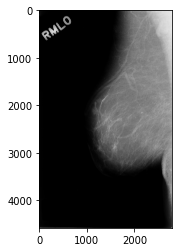

Success.
Resizing DICOM file...
Success.


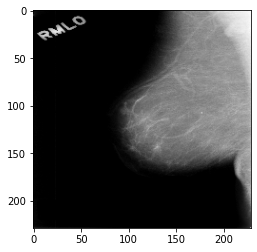

Success.
patient id is P_00092
Reading DICOM file...


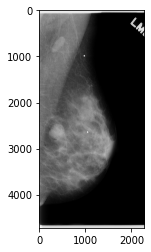

Success.
Resizing DICOM file...
Success.


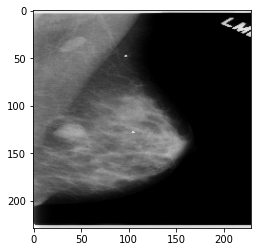

Success.
patient id is P_00289
Reading DICOM file...


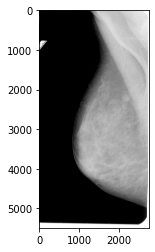

Success.
Resizing DICOM file...
Success.


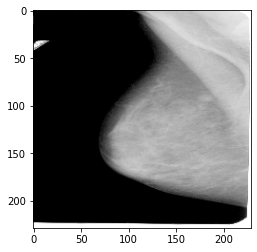

Success.
patient id is P_00108
Reading DICOM file...


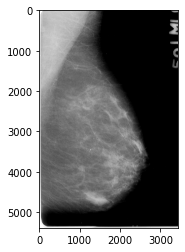

Success.
Resizing DICOM file...
Success.


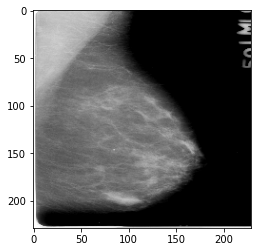

Success.
patient id is P_00094
Reading DICOM file...


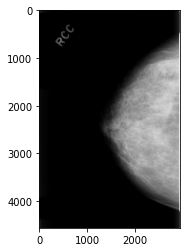

Success.
Resizing DICOM file...
Success.


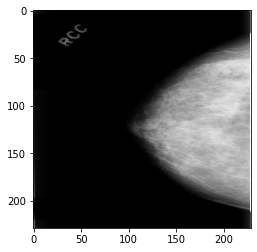

Success.
patient id is P_00241
Reading DICOM file...


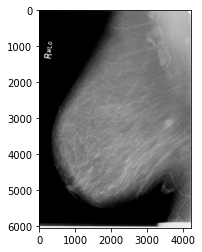

Success.
Resizing DICOM file...
Success.


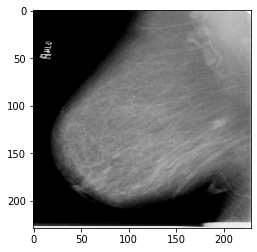

Success.
patient id is P_00314
Reading DICOM file...


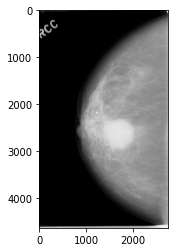

Success.
Resizing DICOM file...
Success.


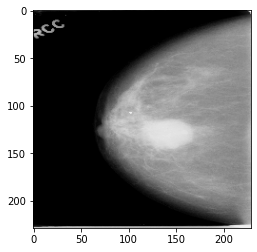

Success.
patient id is P_00146
Reading DICOM file...


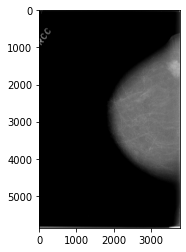

Success.
Resizing DICOM file...
Success.


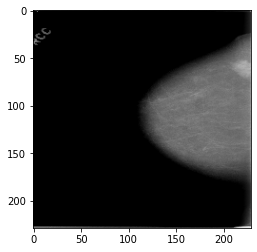

Success.
patient id is P_00412
Reading DICOM file...


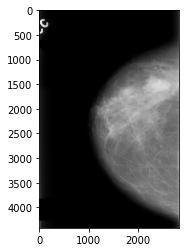

Success.
Resizing DICOM file...
Success.


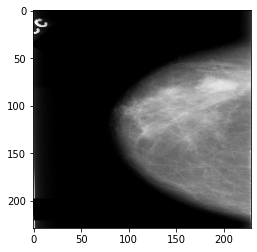

Success.
patient id is P_00092
Reading DICOM file...


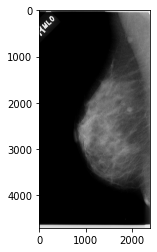

Success.
Resizing DICOM file...
Success.


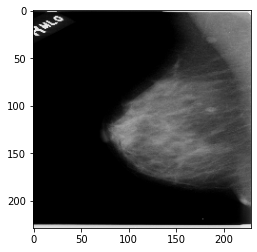

Success.
patient id is P_00332
Reading DICOM file...


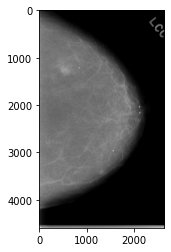

Success.
Resizing DICOM file...
Success.


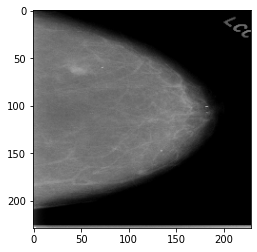

Success.
patient id is P_00137
Reading DICOM file...


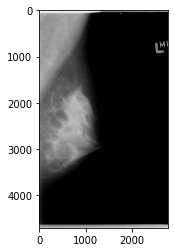

Success.
Resizing DICOM file...
Success.


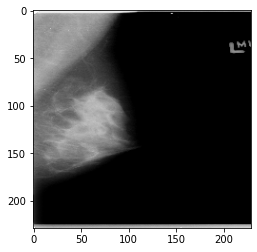

Success.
patient id is P_00044
Reading DICOM file...


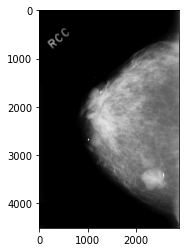

Success.
Resizing DICOM file...
Success.


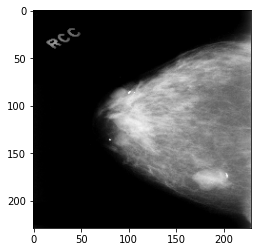

Success.
patient id is P_00086
Reading DICOM file...


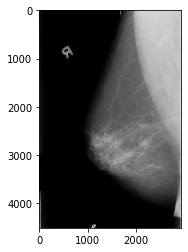

Success.
Resizing DICOM file...
Success.


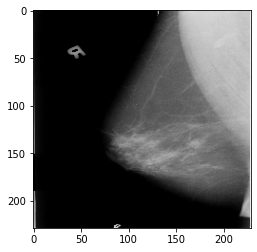

Success.
patient id is P_00351
Reading DICOM file...


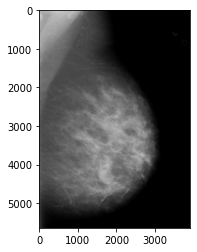

Success.
Resizing DICOM file...
Success.


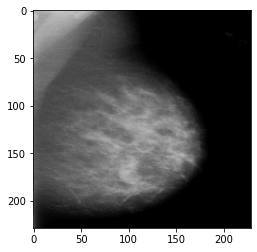

Success.
patient id is P_00207
Reading DICOM file...


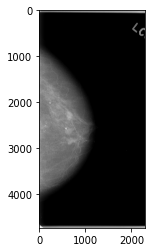

Success.
Resizing DICOM file...
Success.


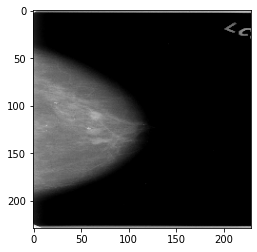

Success.
patient id is P_00001
Reading DICOM file...


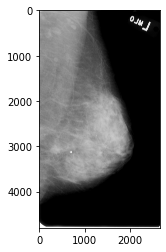

Success.
Resizing DICOM file...
Success.


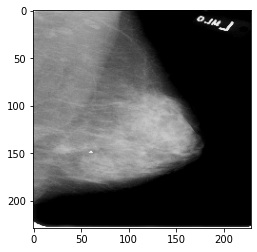

Success.
patient id is P_00319
Reading DICOM file...


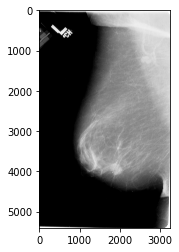

Success.
Resizing DICOM file...
Success.


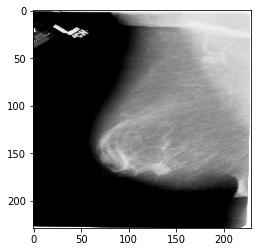

Success.
patient id is P_00217
Reading DICOM file...


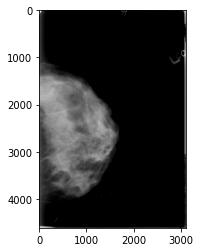

Success.
Resizing DICOM file...
Success.


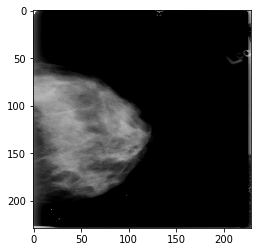

Success.
patient id is P_00026
Reading DICOM file...


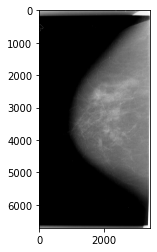

Success.
Resizing DICOM file...
Success.


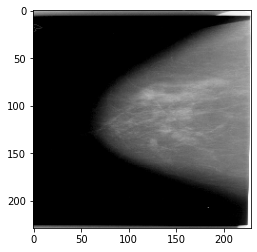

Success.
patient id is P_00236
Reading DICOM file...


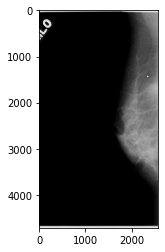

Success.
Resizing DICOM file...
Success.


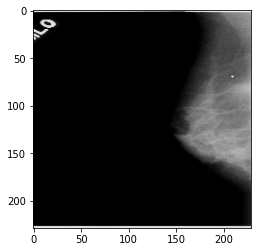

Success.
patient id is P_00045
Reading DICOM file...


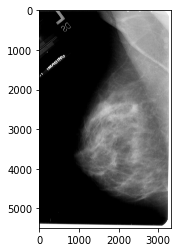

Success.
Resizing DICOM file...
Success.


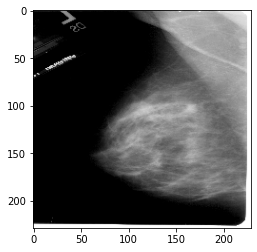

Success.
patient id is P_00076
Reading DICOM file...


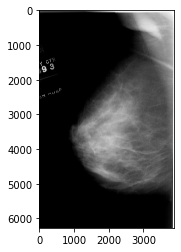

Success.
Resizing DICOM file...
Success.


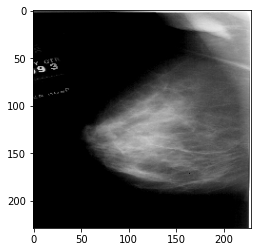

Success.
patient id is P_00146
Reading DICOM file...


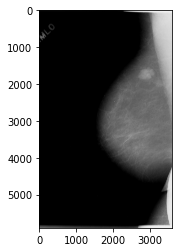

Success.
Resizing DICOM file...
Success.


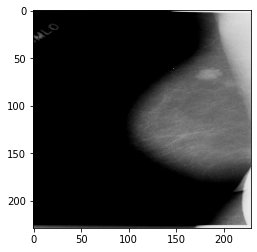

Success.
patient id is P_00370
Reading DICOM file...


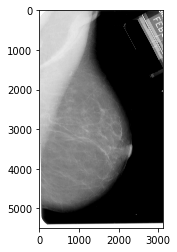

Success.
Resizing DICOM file...
Success.


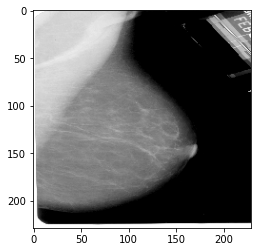

Success.
patient id is P_00283
Reading DICOM file...


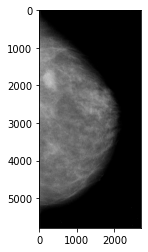

Success.
Resizing DICOM file...
Success.


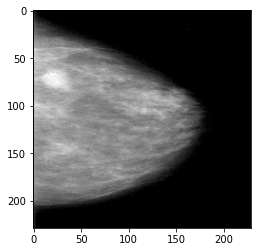

Success.
patient id is P_00314
Reading DICOM file...


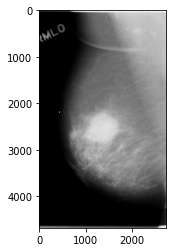

Success.
Resizing DICOM file...
Success.


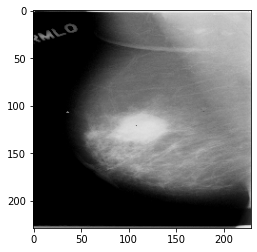

Success.
patient id is P_00259
Reading DICOM file...


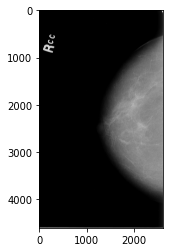

Success.
Resizing DICOM file...
Success.


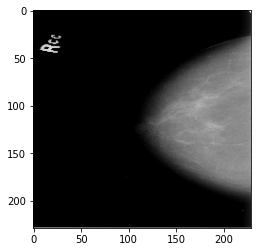

Success.
patient id is P_00408
Reading DICOM file...


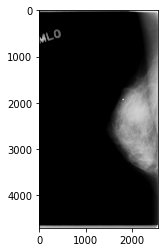

Success.
Resizing DICOM file...
Success.


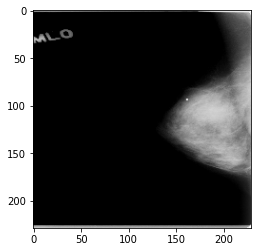

Success.
patient id is P_00122
Reading DICOM file...


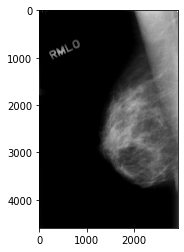

Success.
Resizing DICOM file...
Success.


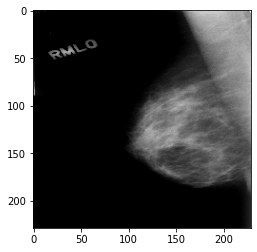

Success.
patient id is P_00137
Reading DICOM file...


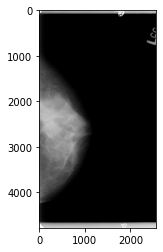

Success.
Resizing DICOM file...
Success.


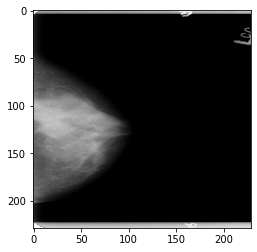

Success.
patient id is P_00386
Reading DICOM file...


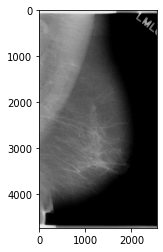

Success.
Resizing DICOM file...
Success.


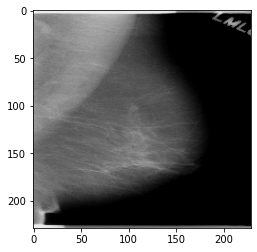

Success.
patient id is P_00108
Reading DICOM file...


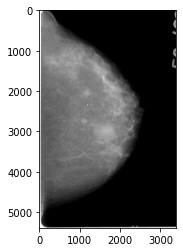

Success.
Resizing DICOM file...
Success.


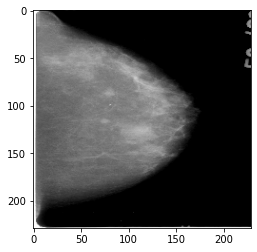

Success.
patient id is P_00363
Reading DICOM file...


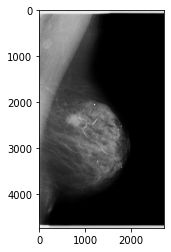

Success.
Resizing DICOM file...
Success.


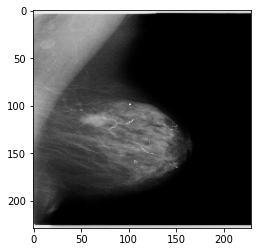

Success.
patient id is P_00092
Reading DICOM file...


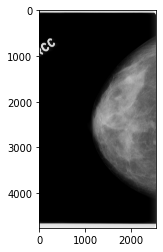

Success.
Resizing DICOM file...
Success.


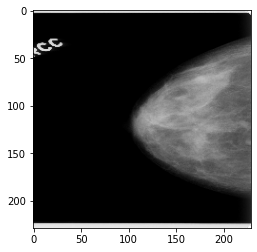

Success.
patient id is P_00254
Reading DICOM file...


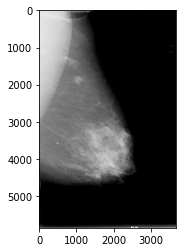

Success.
Resizing DICOM file...
Success.


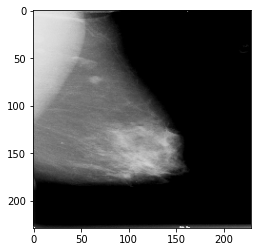

Success.
patient id is P_00064
Reading DICOM file...


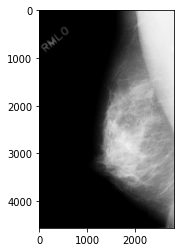

Success.
Resizing DICOM file...
Success.


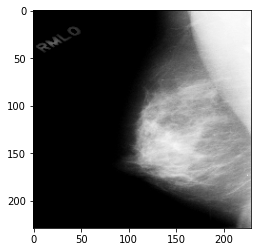

Success.
patient id is P_00172
Reading DICOM file...


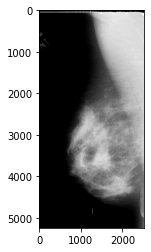

Success.
Resizing DICOM file...
Success.


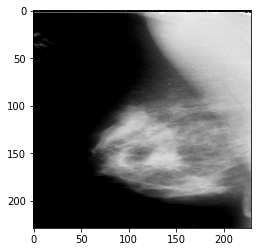

Success.
patient id is P_00330
Reading DICOM file...


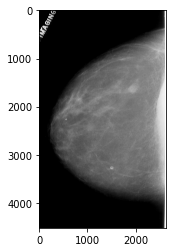

Success.
Resizing DICOM file...
Success.


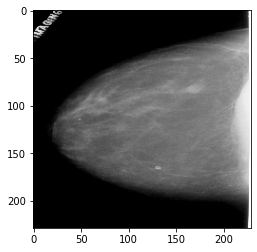

Success.
patient id is P_00414
Reading DICOM file...


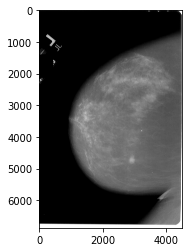

Success.
Resizing DICOM file...
Success.


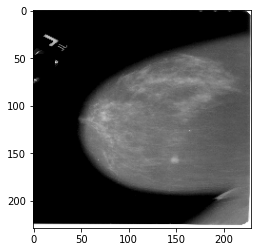

Success.
patient id is P_00187
Reading DICOM file...


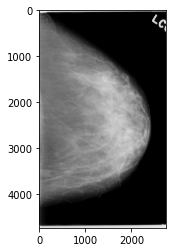

Success.
Resizing DICOM file...
Success.


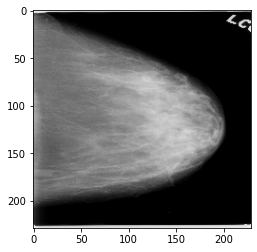

Success.
patient id is P_00411
Reading DICOM file...


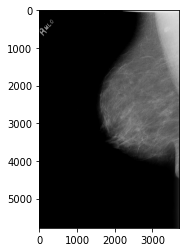

Success.
Resizing DICOM file...
Success.


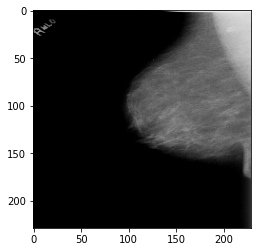

Success.
patient id is P_00320
Reading DICOM file...


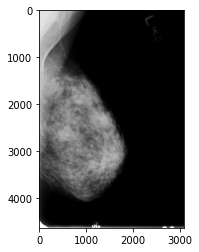

Success.
Resizing DICOM file...
Success.


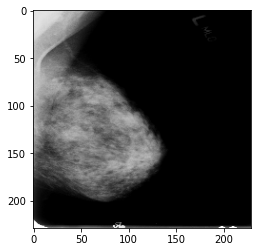

Success.
patient id is P_00174
Reading DICOM file...


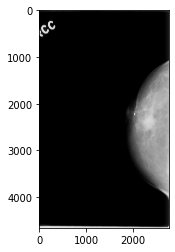

Success.
Resizing DICOM file...
Success.


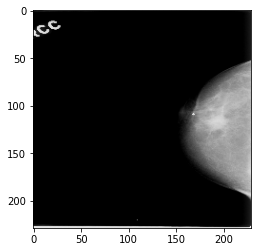

Success.
patient id is P_00175
Reading DICOM file...


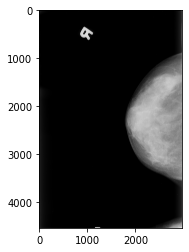

Success.
Resizing DICOM file...
Success.


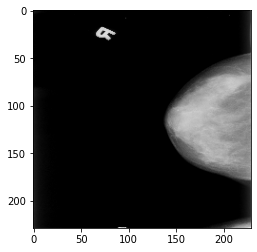

Success.
patient id is P_00320
Reading DICOM file...


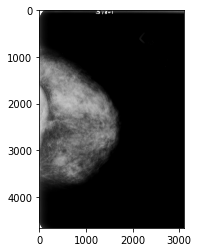

Success.
Resizing DICOM file...
Success.


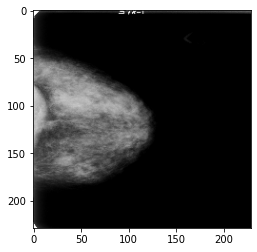

Success.
patient id is P_00095
Reading DICOM file...


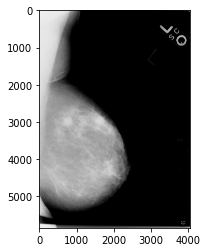

Success.
Resizing DICOM file...
Success.


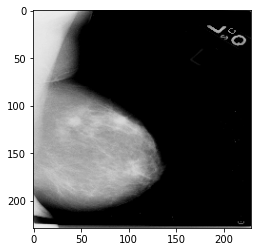

Success.
patient id is P_00313
Reading DICOM file...


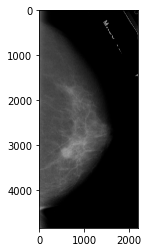

Success.
Resizing DICOM file...
Success.


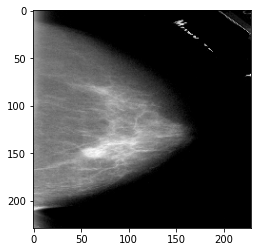

Success.
patient id is P_00034
Reading DICOM file...


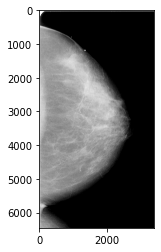

Success.
Resizing DICOM file...
Success.


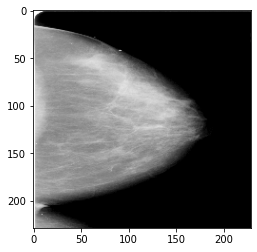

Success.
patient id is P_00229
Reading DICOM file...


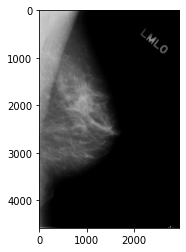

Success.
Resizing DICOM file...
Success.


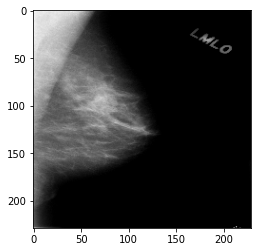

Success.
patient id is P_00081
Reading DICOM file...


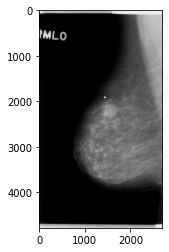

Success.
Resizing DICOM file...
Success.


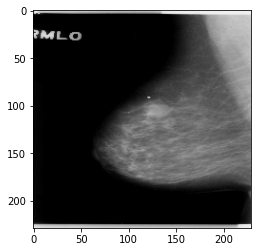

Success.
patient id is P_00174
Reading DICOM file...


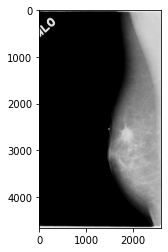

Success.
Resizing DICOM file...
Success.


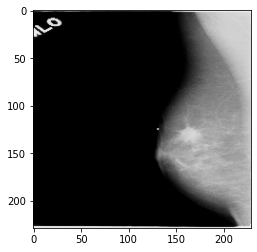

Success.
patient id is P_00061
Reading DICOM file...


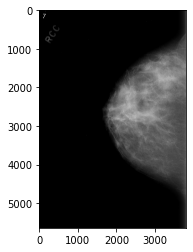

Success.
Resizing DICOM file...
Success.


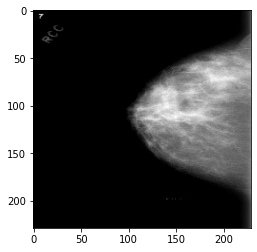

Success.
patient id is P_00225
Reading DICOM file...


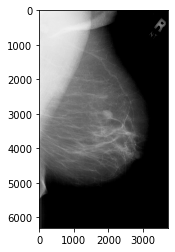

Success.
Resizing DICOM file...
Success.


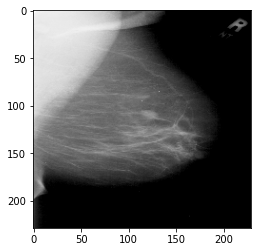

Success.
patient id is P_00039
Reading DICOM file...


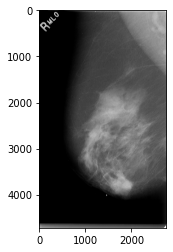

Success.
Resizing DICOM file...
Success.


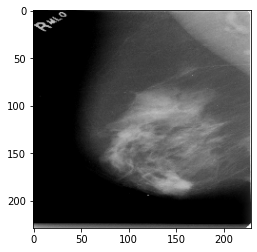

Success.
patient id is P_00333
Reading DICOM file...


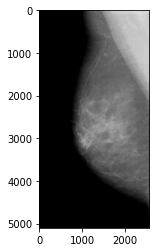

Success.
Resizing DICOM file...
Success.


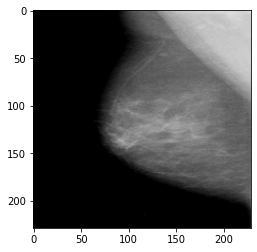

Success.
patient id is P_00160
Reading DICOM file...


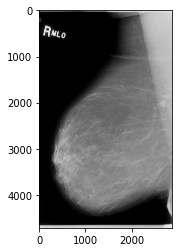

Success.
Resizing DICOM file...
Success.


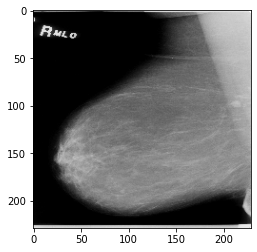

Success.
patient id is P_00225
Reading DICOM file...


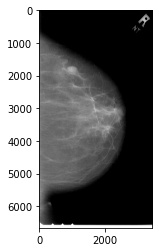

Success.
Resizing DICOM file...
Success.


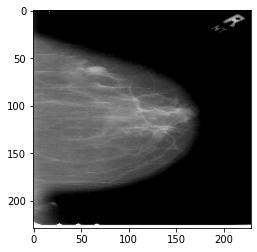

Success.
patient id is P_00342
Reading DICOM file...


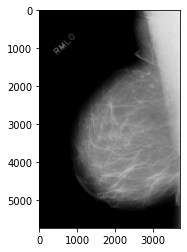

Success.
Resizing DICOM file...
Success.


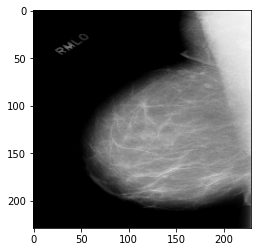

Success.
patient id is P_00224
Reading DICOM file...


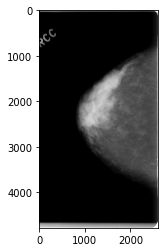

Success.
Resizing DICOM file...
Success.


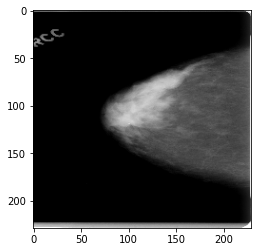

Success.
patient id is P_00057
Reading DICOM file...


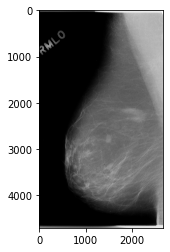

Success.
Resizing DICOM file...
Success.


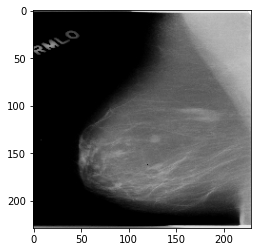

Success.
patient id is P_00303
Reading DICOM file...


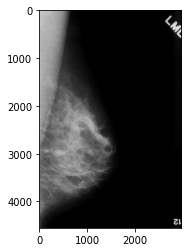

Success.
Resizing DICOM file...
Success.


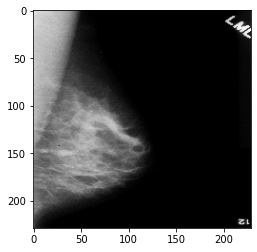

Success.
patient id is P_00172
Reading DICOM file...


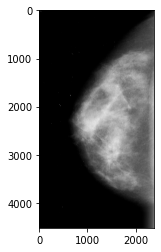

Success.
Resizing DICOM file...
Success.


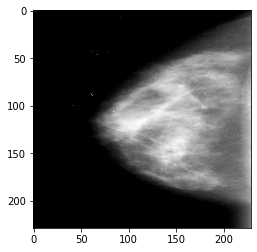

Success.
patient id is P_00298
Reading DICOM file...


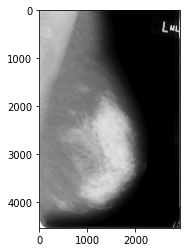

Success.
Resizing DICOM file...
Success.


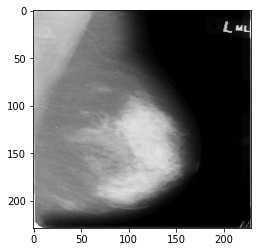

Success.
patient id is P_00240
Reading DICOM file...


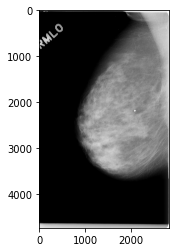

Success.
Resizing DICOM file...
Success.


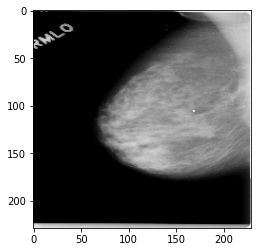

Success.
patient id is P_00059
Reading DICOM file...


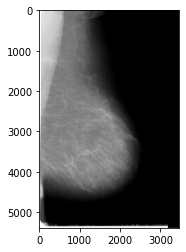

Success.
Resizing DICOM file...
Success.


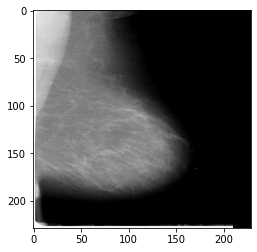

Success.
patient id is P_00034
Reading DICOM file...


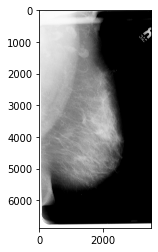

Success.
Resizing DICOM file...
Success.


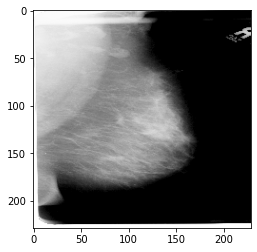

Success.
patient id is P_00110
Reading DICOM file...


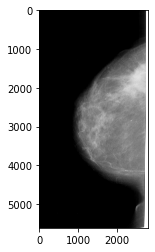

Success.
Resizing DICOM file...
Success.


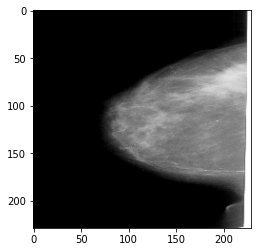

Success.
patient id is P_00018
Reading DICOM file...


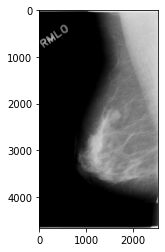

Success.
Resizing DICOM file...
Success.


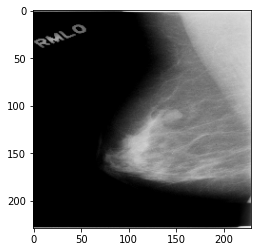

Success.
patient id is P_00239
Reading DICOM file...


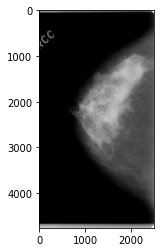

Success.
Resizing DICOM file...
Success.


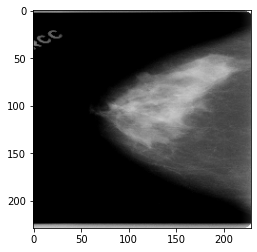

Success.
patient id is P_00248
Reading DICOM file...


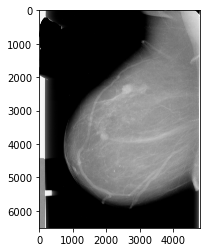

Success.
Resizing DICOM file...
Success.


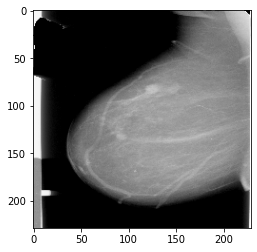

Success.
patient id is P_00109
Reading DICOM file...


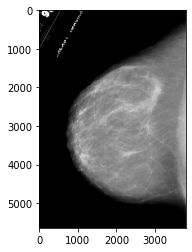

Success.
Resizing DICOM file...
Success.


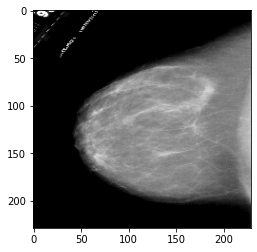

Success.
patient id is P_00408
Reading DICOM file...


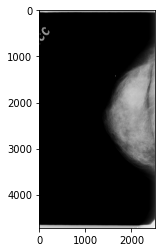

Success.
Resizing DICOM file...
Success.


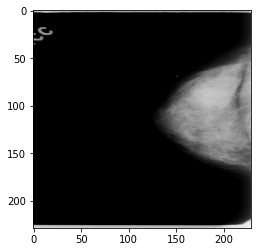

Success.
patient id is P_00119
Reading DICOM file...


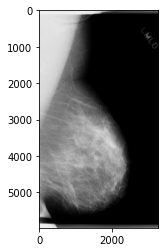

Success.
Resizing DICOM file...
Success.


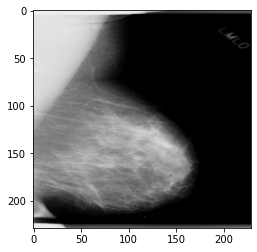

Success.
patient id is P_00166
Reading DICOM file...


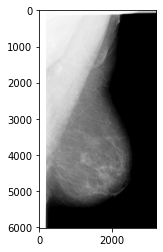

Success.
Resizing DICOM file...
Success.


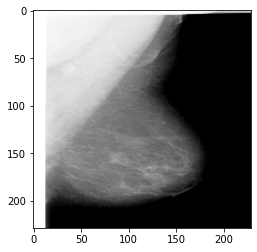

Success.
patient id is P_00309
Reading DICOM file...


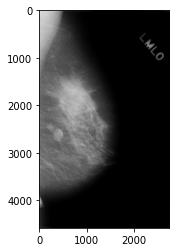

Success.
Resizing DICOM file...
Success.


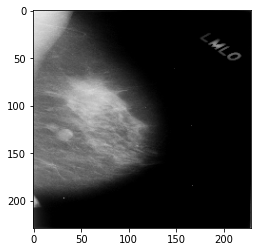

Success.
patient id is P_00399
Reading DICOM file...


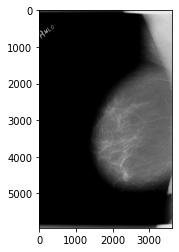

Success.
Resizing DICOM file...
Success.


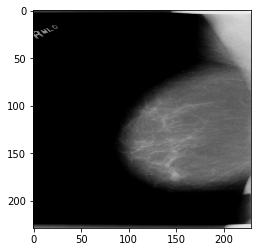

Success.
patient id is P_00119
Reading DICOM file...


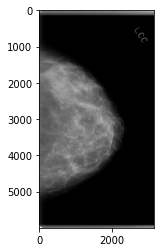

Success.
Resizing DICOM file...
Success.


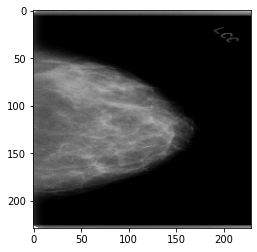

Success.
patient id is P_00023
Reading DICOM file...


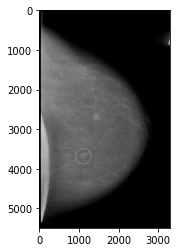

Success.
Resizing DICOM file...
Success.


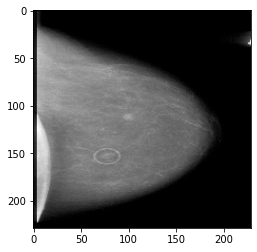

Success.
patient id is P_00095
Reading DICOM file...


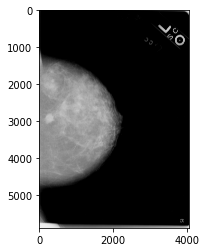

Success.
Resizing DICOM file...
Success.


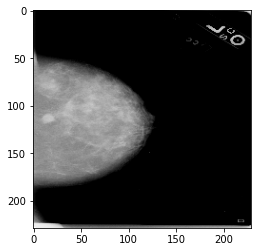

Success.
patient id is P_00046
Reading DICOM file...


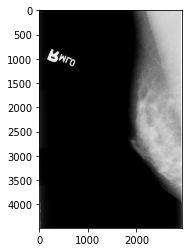

Success.
Resizing DICOM file...
Success.


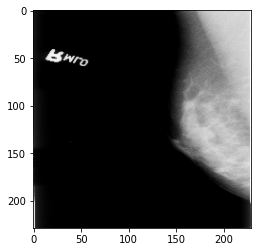

Success.
patient id is P_00264
Reading DICOM file...


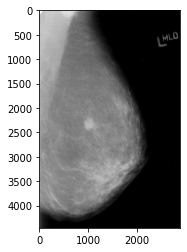

Success.
Resizing DICOM file...
Success.


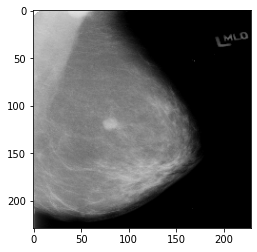

Success.
patient id is P_00259
Reading DICOM file...


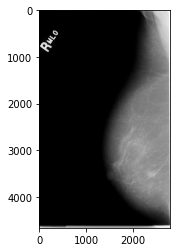

Success.
Resizing DICOM file...
Success.


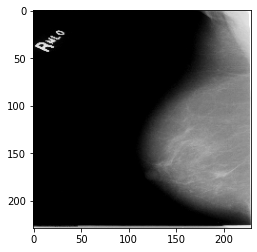

Success.
patient id is P_00199
Reading DICOM file...


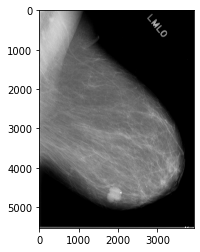

Success.
Resizing DICOM file...
Success.


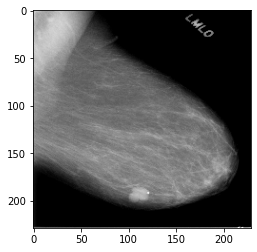

Success.
patient id is P_00385
Reading DICOM file...


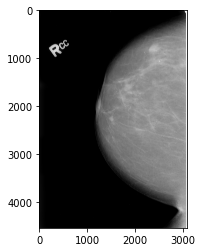

Success.
Resizing DICOM file...
Success.


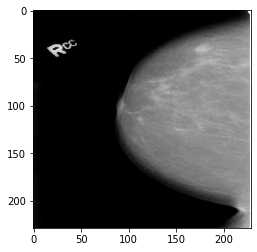

Success.
patient id is P_00384
Reading DICOM file...


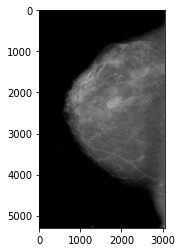

Success.
Resizing DICOM file...
Success.


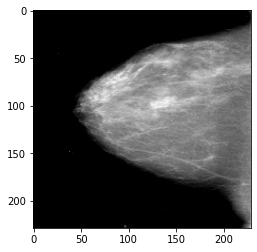

Success.
patient id is P_00079
Reading DICOM file...


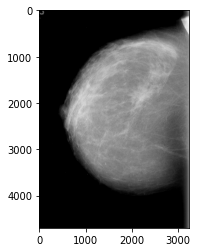

Success.
Resizing DICOM file...
Success.


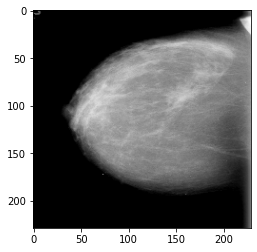

Success.
patient id is P_00090
Reading DICOM file...


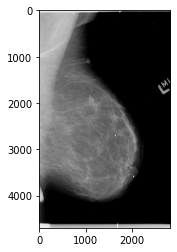

Success.
Resizing DICOM file...
Success.


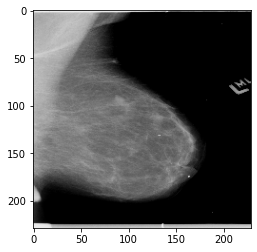

Success.
patient id is P_00385
Reading DICOM file...


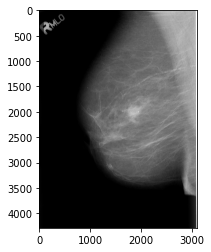

Success.
Resizing DICOM file...
Success.


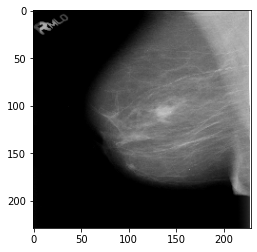

Success.
patient id is P_00218
Reading DICOM file...


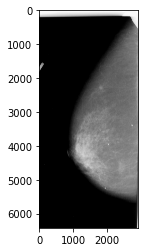

Success.
Resizing DICOM file...
Success.


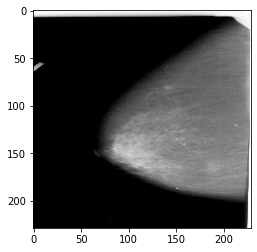

Success.
patient id is P_00328
Reading DICOM file...


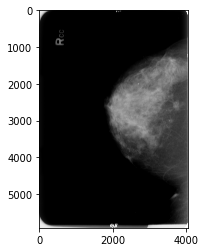

Success.
Resizing DICOM file...
Success.


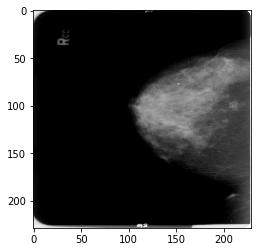

Success.
patient id is P_00133
Reading DICOM file...


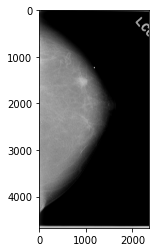

Success.
Resizing DICOM file...
Success.


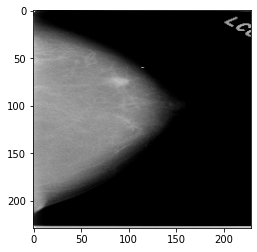

Success.
patient id is P_00281
Reading DICOM file...


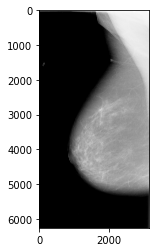

Success.
Resizing DICOM file...
Success.


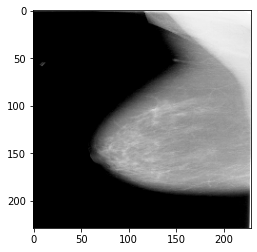

Success.
patient id is P_00134
Reading DICOM file...


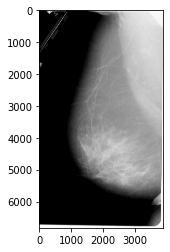

Success.
Resizing DICOM file...
Success.


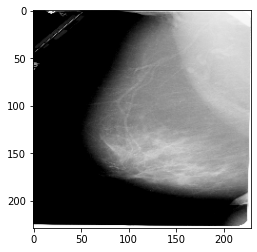

Success.
patient id is P_00106
Reading DICOM file...


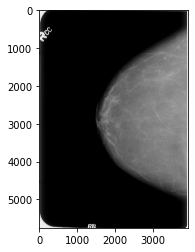

Success.
Resizing DICOM file...
Success.


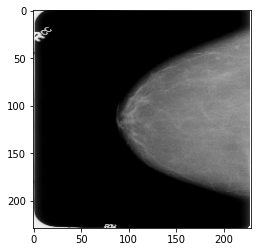

Success.
patient id is P_00303
Reading DICOM file...


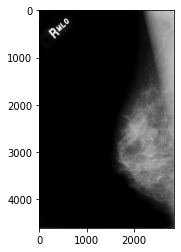

Success.
Resizing DICOM file...
Success.


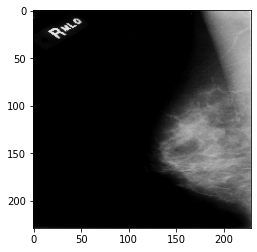

Success.
patient id is P_00074
Reading DICOM file...


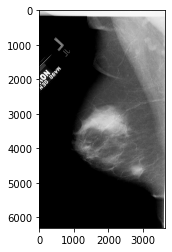

Success.
Resizing DICOM file...
Success.


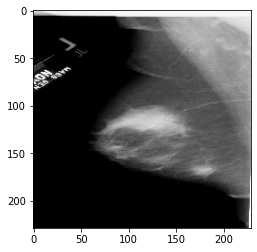

Success.
patient id is P_00090
Reading DICOM file...


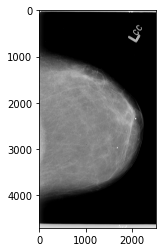

Success.
Resizing DICOM file...
Success.


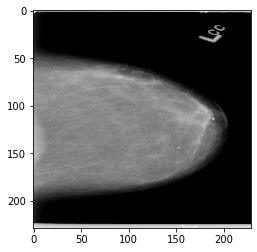

Success.
patient id is P_00317
Reading DICOM file...


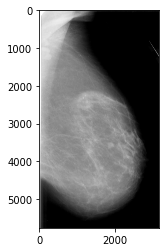

Success.
Resizing DICOM file...
Success.


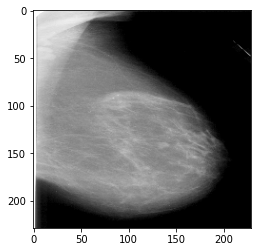

Success.
patient id is P_00009
Reading DICOM file...


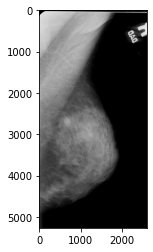

Success.
Resizing DICOM file...
Success.


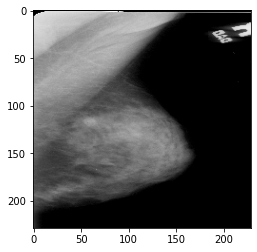

Success.
patient id is P_00389
Reading DICOM file...


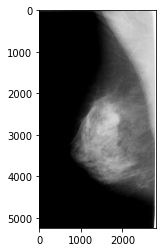

Success.
Resizing DICOM file...
Success.


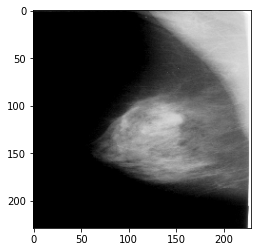

Success.
patient id is P_00287
Reading DICOM file...


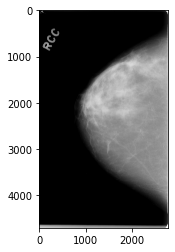

Success.
Resizing DICOM file...
Success.


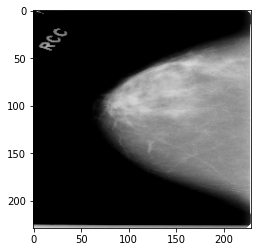

Success.
patient id is P_00273
Reading DICOM file...


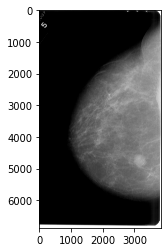

Success.
Resizing DICOM file...
Success.


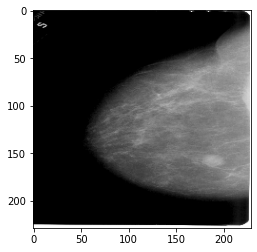

Success.
patient id is P_00226
Reading DICOM file...


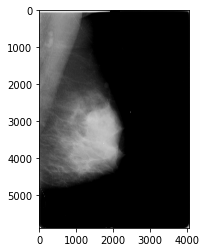

Success.
Resizing DICOM file...
Success.


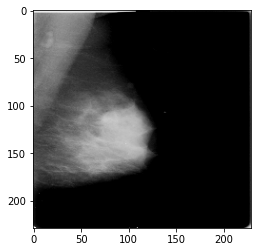

Success.
patient id is P_00096
Reading DICOM file...


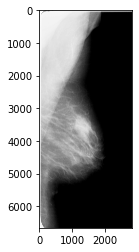

Success.
Resizing DICOM file...
Success.


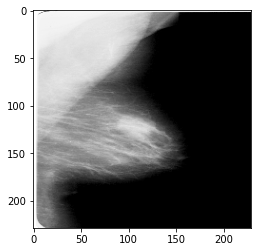

Success.
patient id is P_00215
Reading DICOM file...


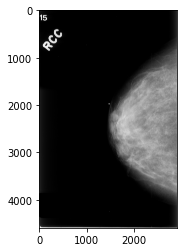

Success.
Resizing DICOM file...
Success.


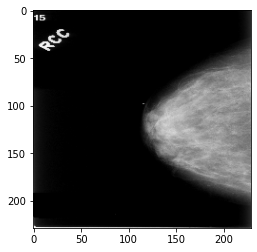

Success.
patient id is P_00383
Reading DICOM file...


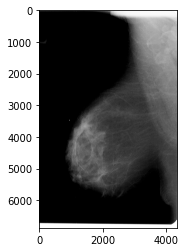

Success.
Resizing DICOM file...
Success.


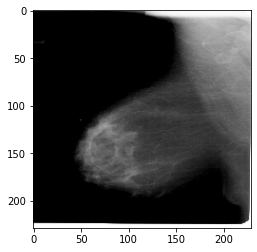

Success.
patient id is P_00041
Reading DICOM file...


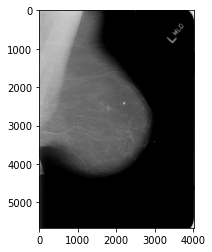

Success.
Resizing DICOM file...
Success.


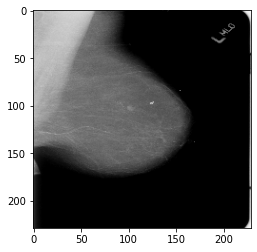

Success.
patient id is P_00149
Reading DICOM file...


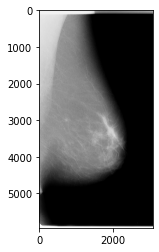

Success.
Resizing DICOM file...
Success.


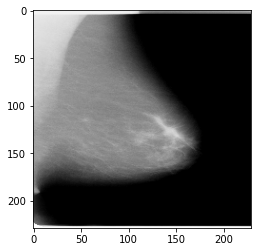

Success.
patient id is P_00406
Reading DICOM file...


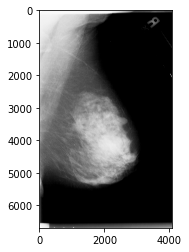

Success.
Resizing DICOM file...
Success.


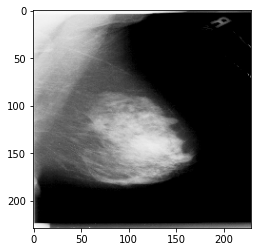

Success.
patient id is P_00241
Reading DICOM file...


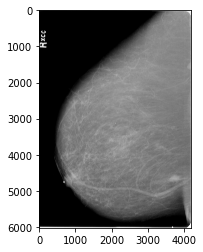

Success.
Resizing DICOM file...
Success.


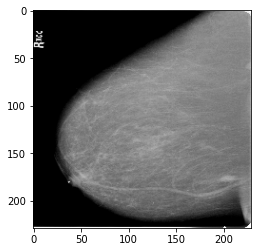

Success.
patient id is P_00004
Reading DICOM file...


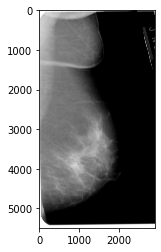

Success.
Resizing DICOM file...
Success.


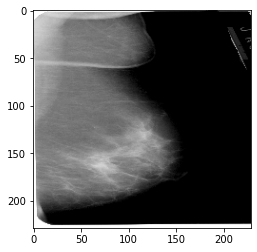

Success.
patient id is P_00411
Reading DICOM file...


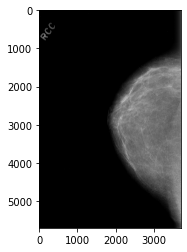

Success.
Resizing DICOM file...
Success.


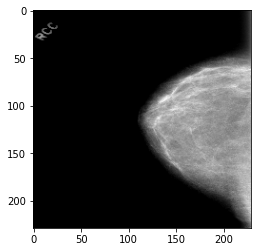

Success.
patient id is P_00027
Reading DICOM file...


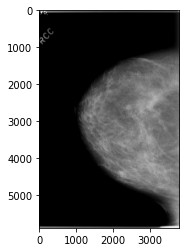

Success.
Resizing DICOM file...
Success.


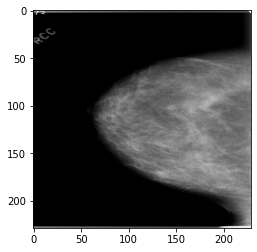

Success.
patient id is P_00412
Reading DICOM file...


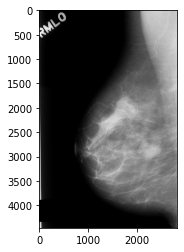

Success.
Resizing DICOM file...
Success.


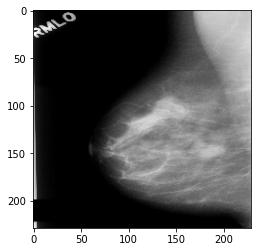

Success.
patient id is P_00096
Reading DICOM file...


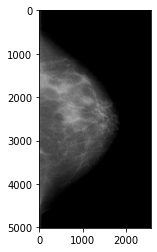

Success.
Resizing DICOM file...
Success.


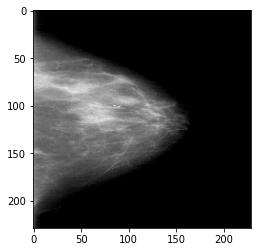

Success.
patient id is P_00401
Reading DICOM file...


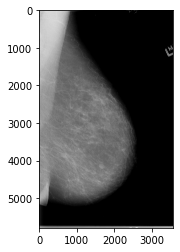

Success.
Resizing DICOM file...
Success.


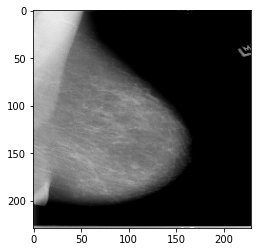

Success.
patient id is P_00240
Reading DICOM file...


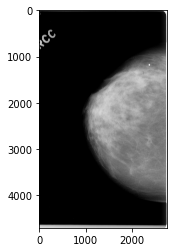

Success.
Resizing DICOM file...
Success.


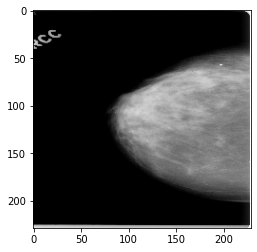

Success.
patient id is P_00356
Reading DICOM file...


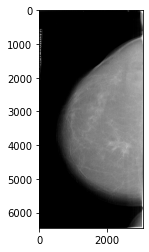

Success.
Resizing DICOM file...
Success.


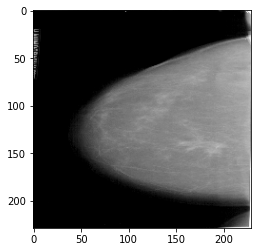

Success.
patient id is P_00218
Reading DICOM file...


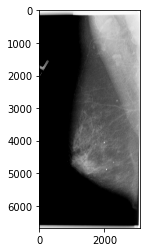

Success.
Resizing DICOM file...
Success.


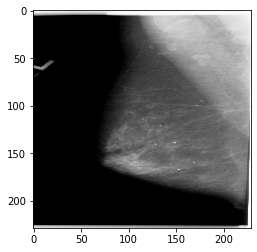

Success.
patient id is P_00021
Reading DICOM file...


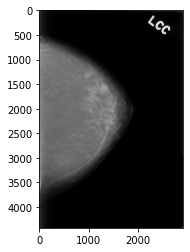

Success.
Resizing DICOM file...
Success.


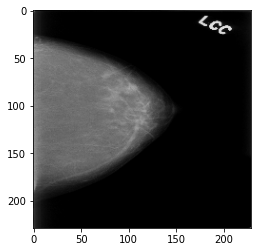

Success.
patient id is P_00015
Reading DICOM file...


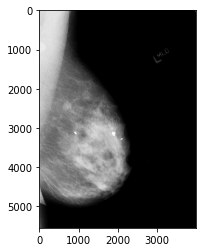

Success.
Resizing DICOM file...
Success.


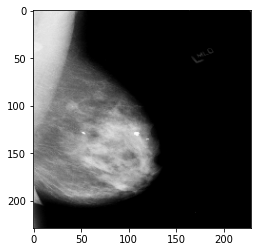

Success.
patient id is P_00018
Reading DICOM file...


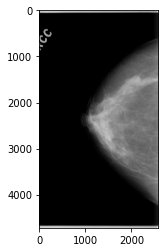

Success.
Resizing DICOM file...
Success.


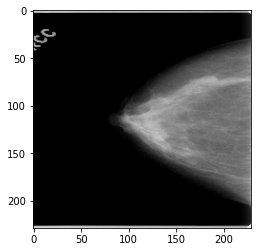

Success.
patient id is P_00166
Reading DICOM file...


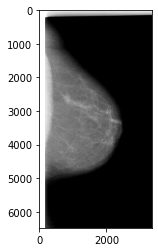

Success.
Resizing DICOM file...
Success.


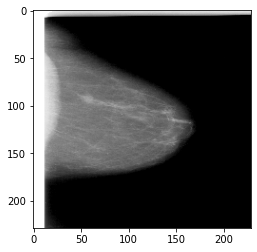

Success.
patient id is P_00239
Reading DICOM file...


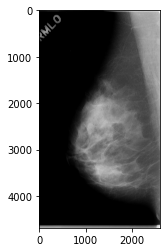

Success.
Resizing DICOM file...
Success.


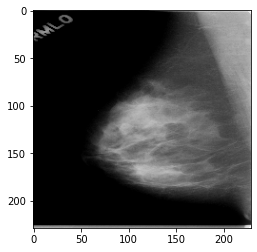

Success.
patient id is P_00376
Reading DICOM file...


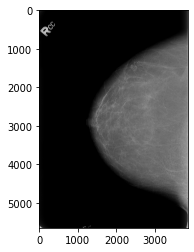

Success.
Resizing DICOM file...
Success.


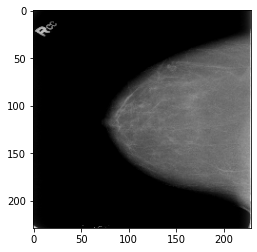

Success.
patient id is P_00332
Reading DICOM file...


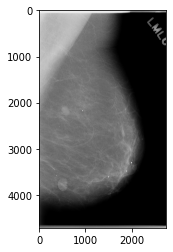

Success.
Resizing DICOM file...
Success.


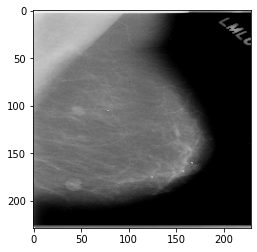

Success.
patient id is P_00054
Reading DICOM file...


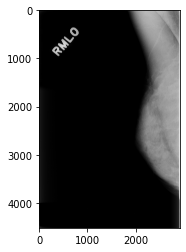

Success.
Resizing DICOM file...
Success.


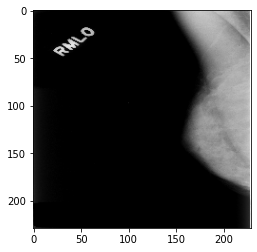

Success.
patient id is P_00110
Reading DICOM file...


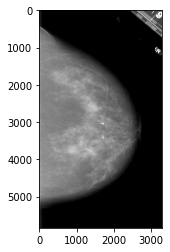

Success.
Resizing DICOM file...
Success.


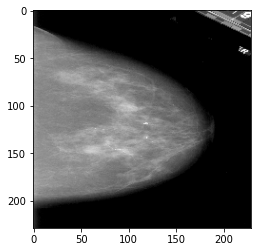

Success.
patient id is P_00061
Reading DICOM file...


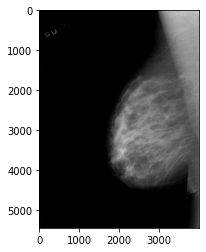

Success.
Resizing DICOM file...
Success.


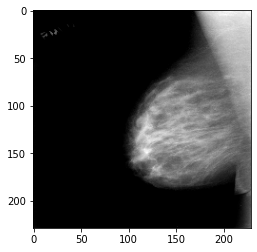

Success.
patient id is P_00149
Reading DICOM file...


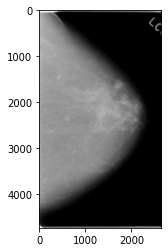

Success.
Resizing DICOM file...
Success.


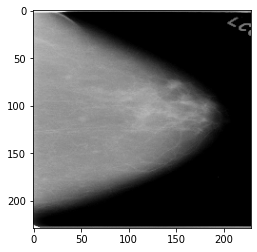

Success.
patient id is P_00287
Reading DICOM file...


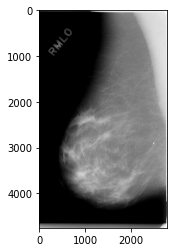

Success.
Resizing DICOM file...
Success.


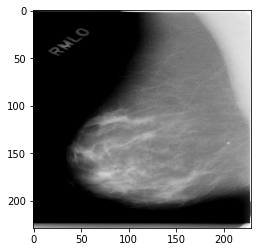

Success.
patient id is P_00106
Reading DICOM file...


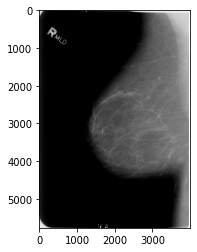

Success.
Resizing DICOM file...
Success.


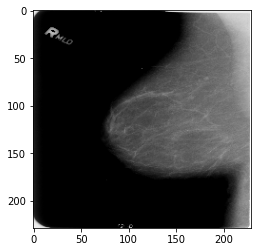

Success.
patient id is P_00065
Reading DICOM file...


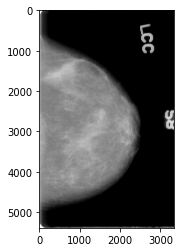

Success.
Resizing DICOM file...
Success.


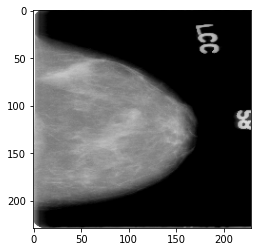

Success.
patient id is P_00303
Reading DICOM file...


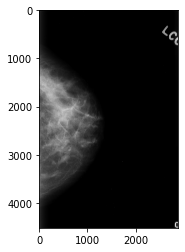

Success.
Resizing DICOM file...
Success.


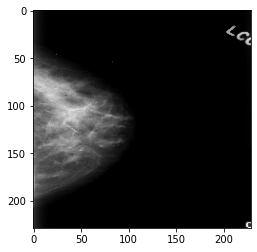

Success.
patient id is P_00117
Reading DICOM file...


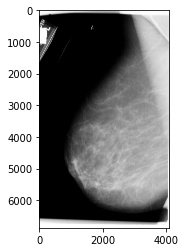

Success.
Resizing DICOM file...
Success.


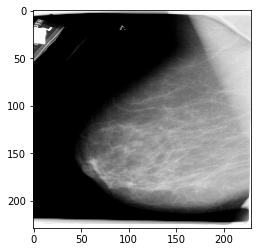

Success.
patient id is P_00342
Reading DICOM file...


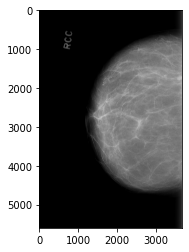

Success.
Resizing DICOM file...
Success.


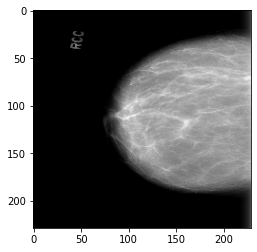

Success.
patient id is P_00231
Reading DICOM file...


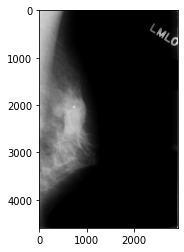

Success.
Resizing DICOM file...
Success.


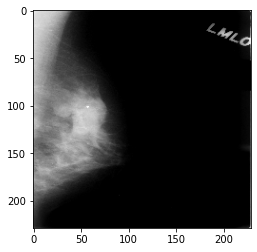

Success.
patient id is P_00399
Reading DICOM file...


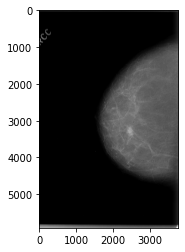

Success.
Resizing DICOM file...
Success.


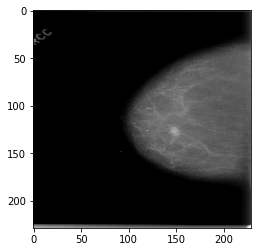

Success.
patient id is P_00366
Reading DICOM file...


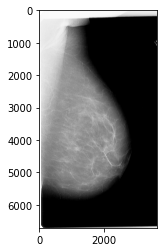

Success.
Resizing DICOM file...
Success.


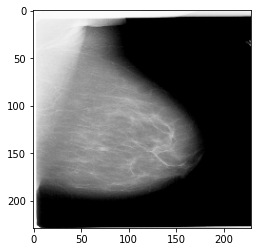

Success.
patient id is P_00160
Reading DICOM file...


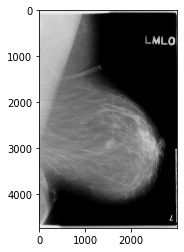

Success.
Resizing DICOM file...
Success.


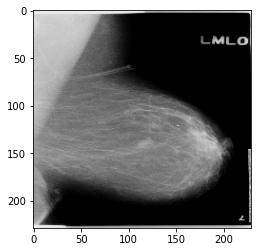

Success.
patient id is P_00226
Reading DICOM file...


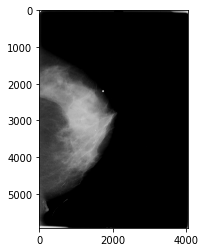

Success.
Resizing DICOM file...
Success.


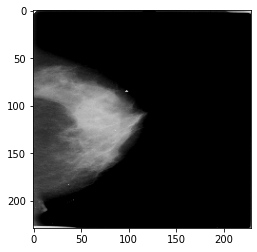

Success.
patient id is P_00401
Reading DICOM file...


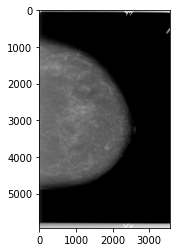

Success.
Resizing DICOM file...
Success.


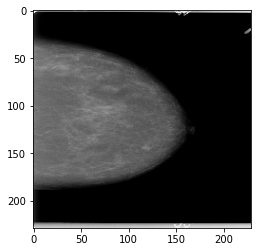

Success.
patient id is P_00023
Reading DICOM file...


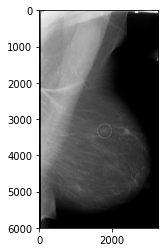

Success.
Resizing DICOM file...
Success.


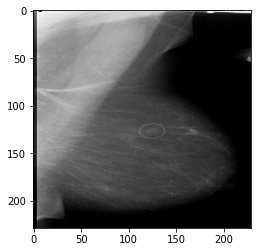

Success.
patient id is P_00406
Reading DICOM file...


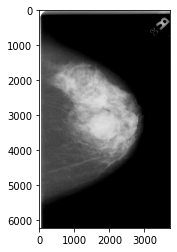

Success.
Resizing DICOM file...
Success.


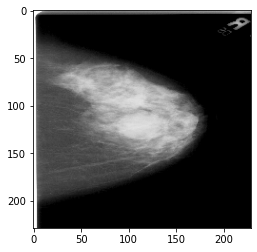

Success.
patient id is P_00021
Reading DICOM file...


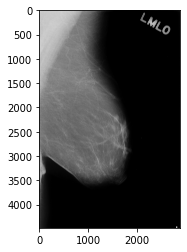

Success.
Resizing DICOM file...
Success.


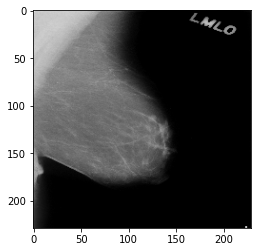

Success.
patient id is P_00081
Reading DICOM file...


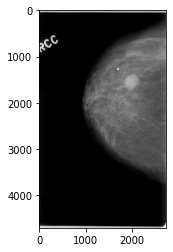

Success.
Resizing DICOM file...
Success.


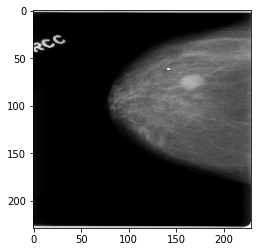

Success.
patient id is P_00334
Reading DICOM file...


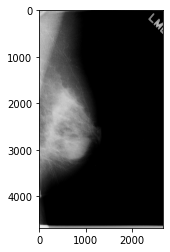

Success.
Resizing DICOM file...
Success.


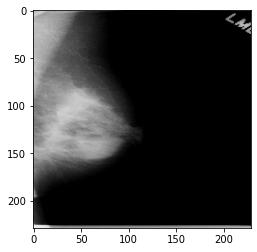

Success.
patient id is P_00254
Reading DICOM file...


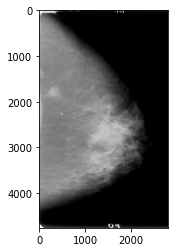

Success.
Resizing DICOM file...
Success.


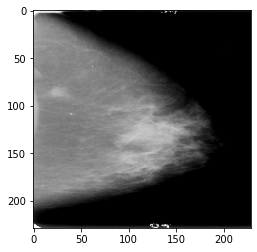

Success.
patient id is P_00080
Reading DICOM file...


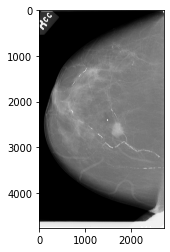

Success.
Resizing DICOM file...
Success.


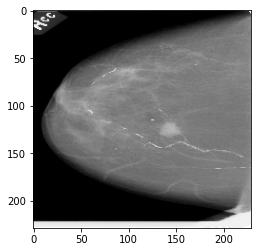

Success.
patient id is P_00384
Reading DICOM file...


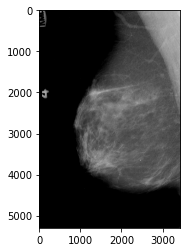

Success.
Resizing DICOM file...
Success.


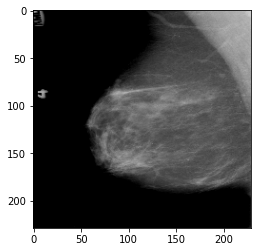

Success.
patient id is P_00335
Reading DICOM file...


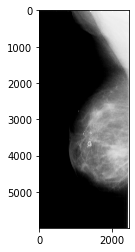

Success.
Resizing DICOM file...
Success.


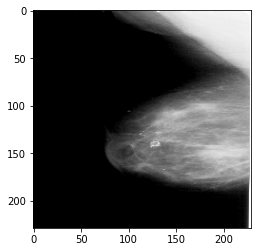

Success.
patient id is P_00106
Reading DICOM file...


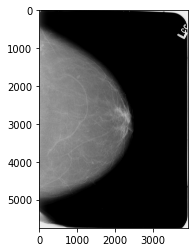

Success.
Resizing DICOM file...
Success.


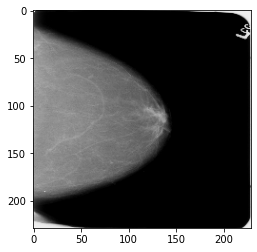

Success.
patient id is P_00370
Reading DICOM file...


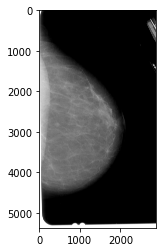

Success.
Resizing DICOM file...
Success.


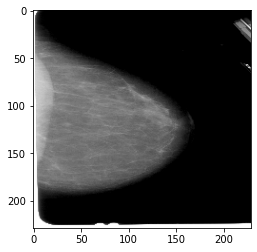

Success.
patient id is P_00068
Reading DICOM file...


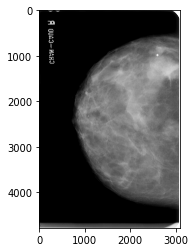

Success.
Resizing DICOM file...
Success.


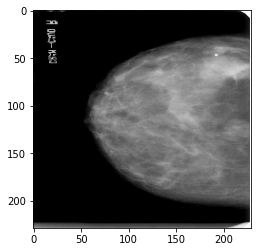

Success.
patient id is P_00247
Reading DICOM file...


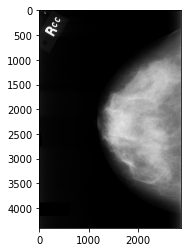

Success.
Resizing DICOM file...
Success.


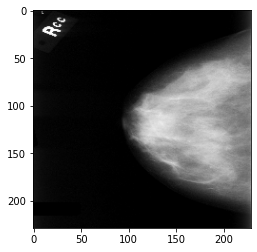

Success.
patient id is P_00021
Reading DICOM file...


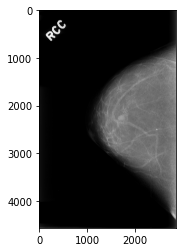

Success.
Resizing DICOM file...
Success.


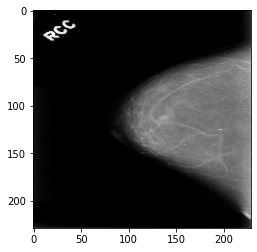

Success.
patient id is P_00265
Reading DICOM file...


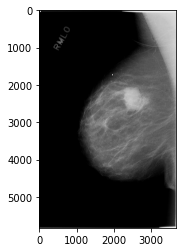

Success.
Resizing DICOM file...
Success.


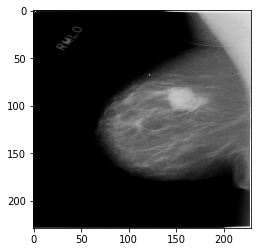

Success.
patient id is P_00160
Reading DICOM file...


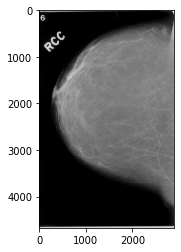

Success.
Resizing DICOM file...
Success.


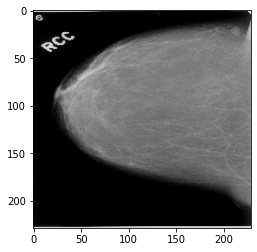

Success.
patient id is P_00294
Reading DICOM file...


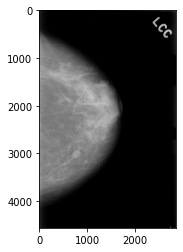

Success.
Resizing DICOM file...
Success.


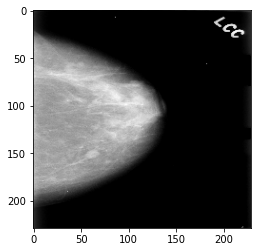

Success.
patient id is P_00051
Reading DICOM file...


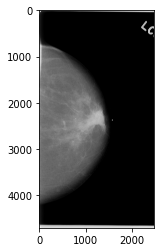

Success.
Resizing DICOM file...
Success.


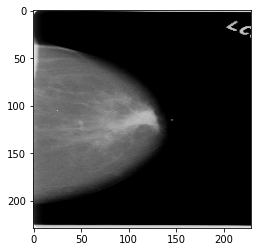

Success.
patient id is P_00041
Reading DICOM file...


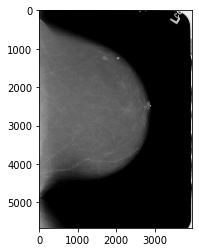

Success.
Resizing DICOM file...
Success.


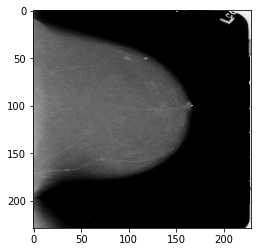

Success.
patient id is P_00363
Reading DICOM file...


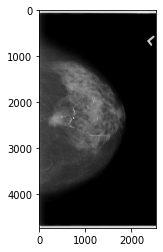

Success.
Resizing DICOM file...
Success.


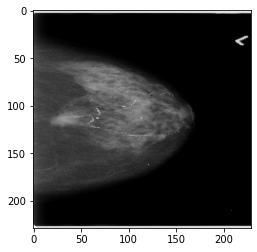

Success.
patient id is P_00279
Reading DICOM file...


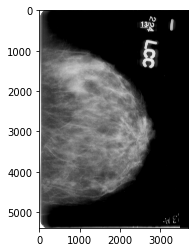

Success.
Resizing DICOM file...
Success.


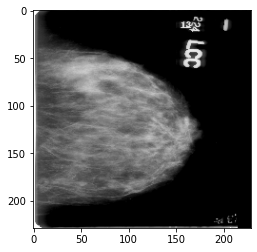

Success.
patient id is P_00057
Reading DICOM file...


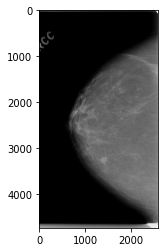

Success.
Resizing DICOM file...
Success.


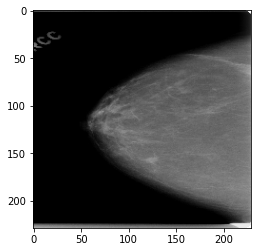

Success.
patient id is P_00110
Reading DICOM file...


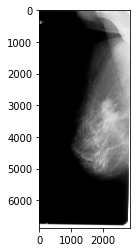

Success.
Resizing DICOM file...
Success.


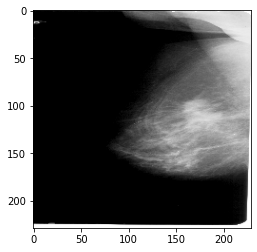

Success.
patient id is P_00065
Reading DICOM file...


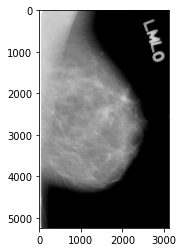

Success.
Resizing DICOM file...
Success.


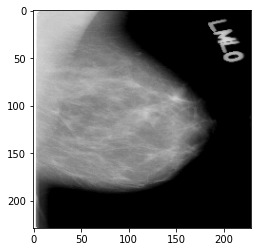

Success.
patient id is P_00206
Reading DICOM file...


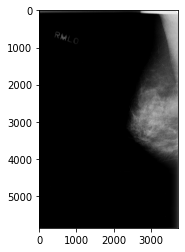

Success.
Resizing DICOM file...
Success.


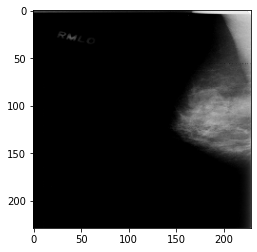

Success.
patient id is P_00205
Reading DICOM file...


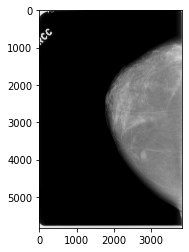

Success.
Resizing DICOM file...
Success.


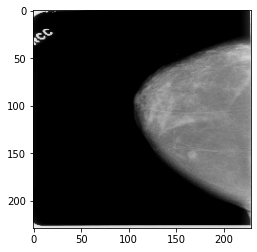

Success.
patient id is P_00051
Reading DICOM file...


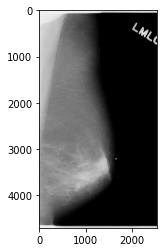

Success.
Resizing DICOM file...
Success.


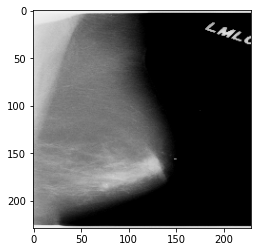

Success.
patient id is P_00120
Reading DICOM file...


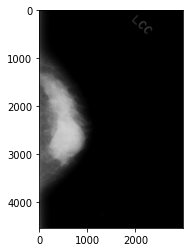

Success.
Resizing DICOM file...
Success.


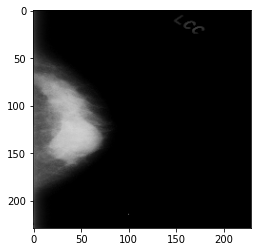

Success.
patient id is P_00234
Reading DICOM file...


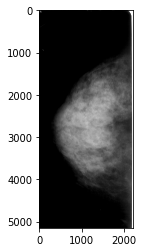

Success.
Resizing DICOM file...
Success.


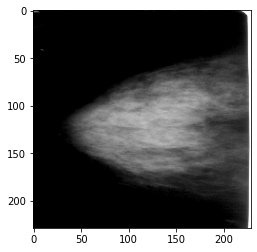

Success.
patient id is P_00086
Reading DICOM file...


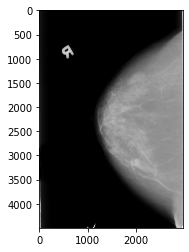

Success.
Resizing DICOM file...
Success.


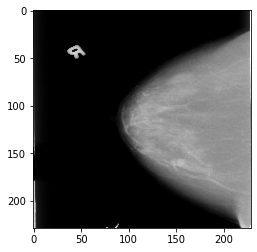

Success.
patient id is P_00348
Reading DICOM file...


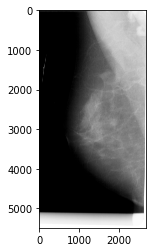

Success.
Resizing DICOM file...
Success.


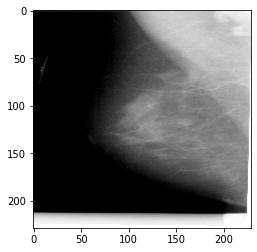

Success.
patient id is P_00333
Reading DICOM file...


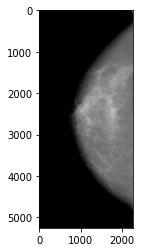

Success.
Resizing DICOM file...
Success.


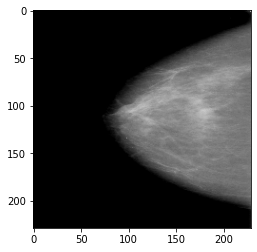

Success.
patient id is P_00026
Reading DICOM file...


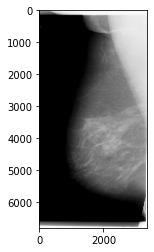

Success.
Resizing DICOM file...
Success.


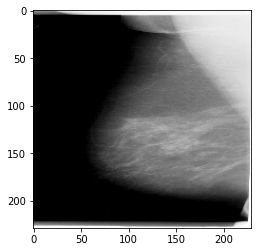

Success.
patient id is P_00332
Reading DICOM file...


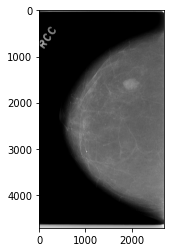

Success.
Resizing DICOM file...
Success.


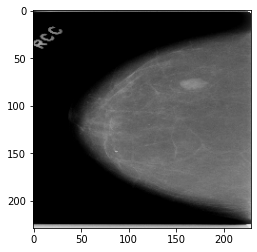

Success.
patient id is P_00199
Reading DICOM file...


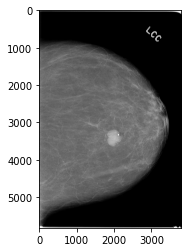

Success.
Resizing DICOM file...
Success.


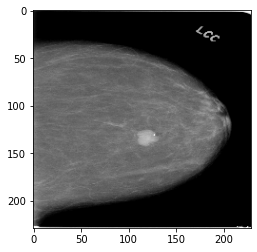

Success.
patient id is P_00224
Reading DICOM file...


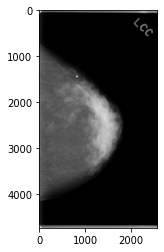

Success.
Resizing DICOM file...
Success.


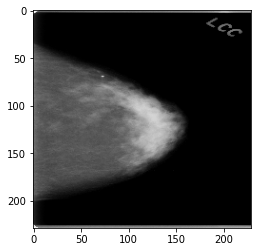

Success.
patient id is P_00361
Reading DICOM file...


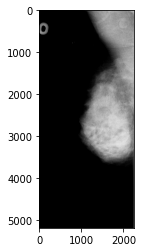

Success.
Resizing DICOM file...
Success.


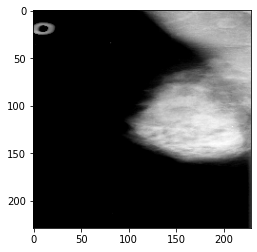

Success.
patient id is P_00148
Reading DICOM file...


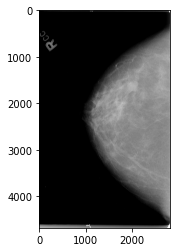

Success.
Resizing DICOM file...
Success.


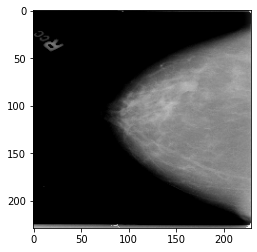

Success.
patient id is P_00004
Reading DICOM file...


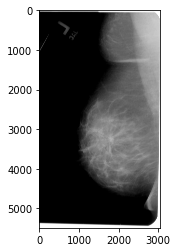

Success.
Resizing DICOM file...
Success.


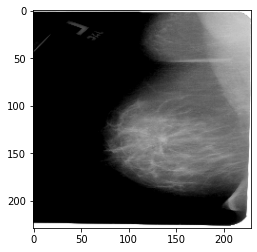

Success.
patient id is P_00386
Reading DICOM file...


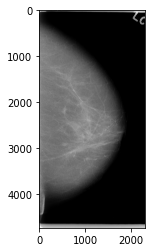

Success.
Resizing DICOM file...
Success.


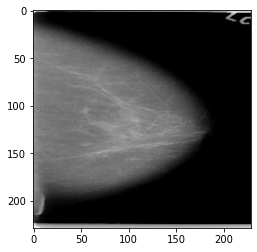

Success.
patient id is P_00074
Reading DICOM file...


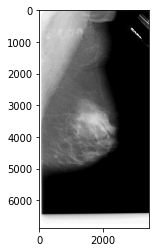

Success.
Resizing DICOM file...
Success.


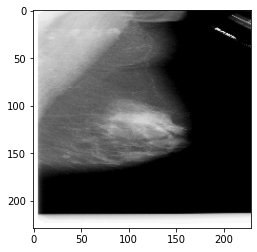

Success.
patient id is P_00219
Reading DICOM file...


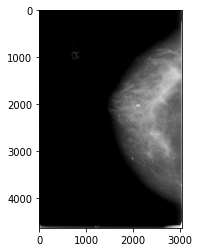

Success.
Resizing DICOM file...
Success.


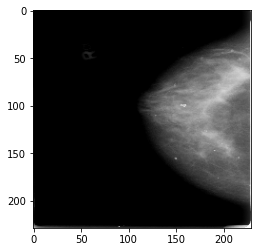

Success.
patient id is P_00004
Reading DICOM file...


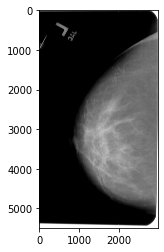

Success.
Resizing DICOM file...
Success.


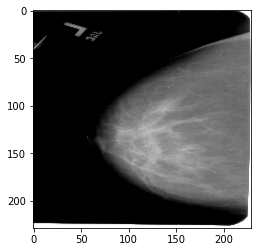

Success.
patient id is P_00076
Reading DICOM file...


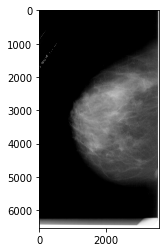

Success.
Resizing DICOM file...
Success.


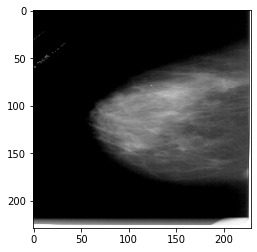

Success.
patient id is P_00242
Reading DICOM file...


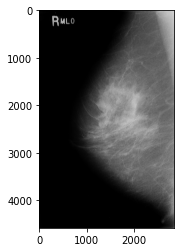

Success.
Resizing DICOM file...
Success.


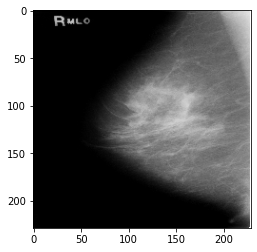

Success.
patient id is P_00148
Reading DICOM file...


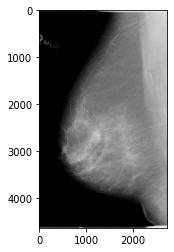

Success.
Resizing DICOM file...
Success.


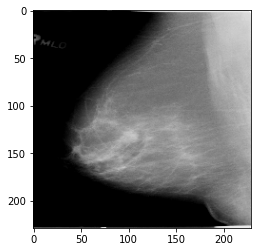

Success.
patient id is P_00396
Reading DICOM file...


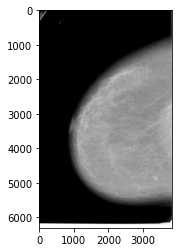

Success.
Resizing DICOM file...
Success.


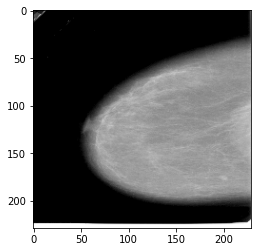

Success.
patient id is P_00107
Reading DICOM file...


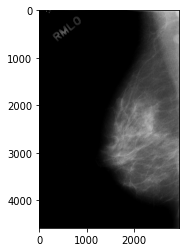

Success.
Resizing DICOM file...
Success.


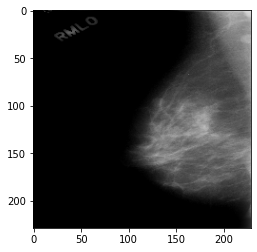

Success.
patient id is P_00079
Reading DICOM file...


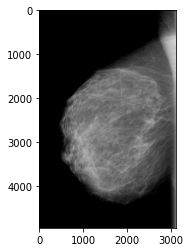

Success.
Resizing DICOM file...
Success.


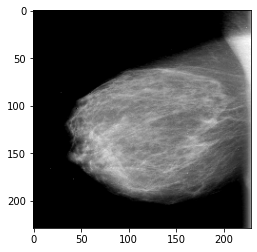

Success.
patient id is P_00059
Reading DICOM file...


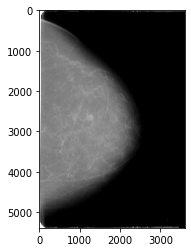

Success.
Resizing DICOM file...
Success.


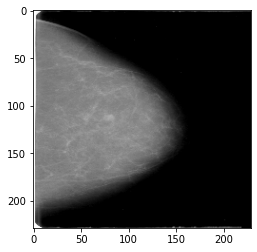

Success.
patient id is P_00133
Reading DICOM file...


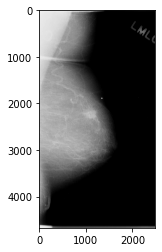

Success.
Resizing DICOM file...
Success.


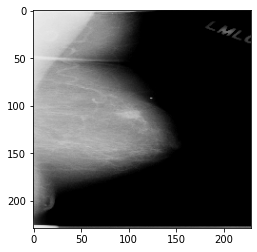

Success.
patient id is P_00366
Reading DICOM file...


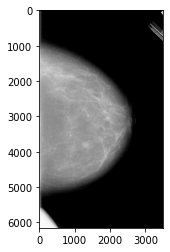

Success.
Resizing DICOM file...
Success.


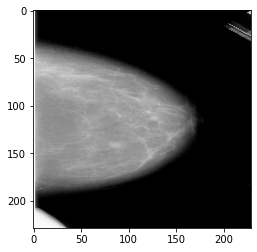

Success.
patient id is P_00328
Reading DICOM file...


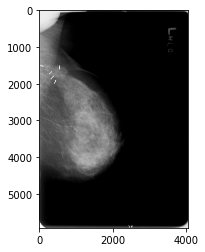

Success.
Resizing DICOM file...
Success.


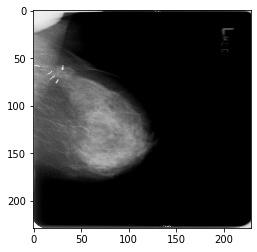

Success.
patient id is P_00092
Reading DICOM file...


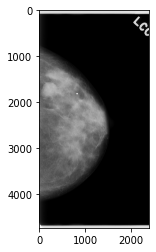

Success.
Resizing DICOM file...
Success.


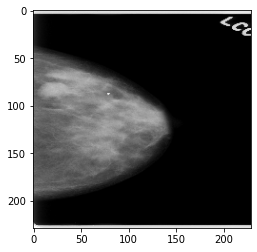

Success.
patient id is P_00354
Reading DICOM file...


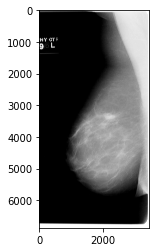

Success.
Resizing DICOM file...
Success.


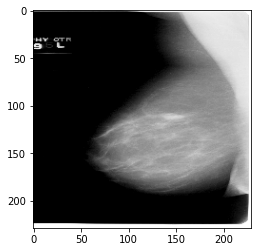

Success.
patient id is P_00009
Reading DICOM file...


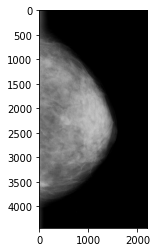

Success.
Resizing DICOM file...
Success.


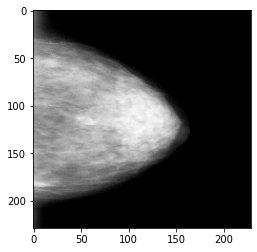

Success.
patient id is P_00169
Reading DICOM file...


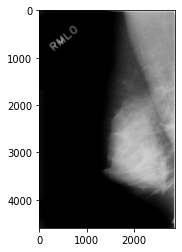

Success.
Resizing DICOM file...
Success.


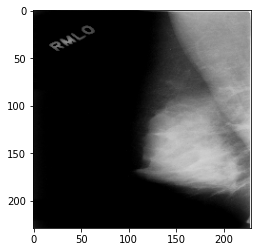

Success.
patient id is P_00128
Reading DICOM file...


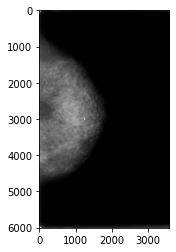

Success.
Resizing DICOM file...
Success.


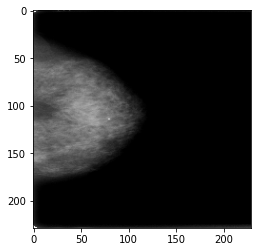

Success.
patient id is P_00265
Reading DICOM file...


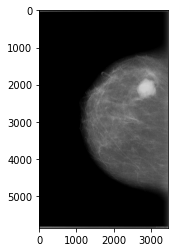

Success.
Resizing DICOM file...
Success.


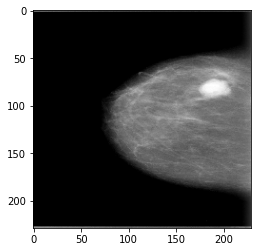

Success.
patient id is P_00354
Reading DICOM file...


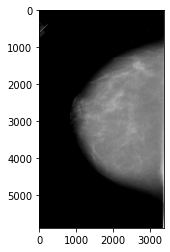

Success.
Resizing DICOM file...
Success.


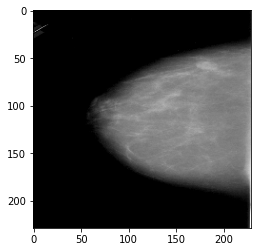

Success.
patient id is P_00319
Reading DICOM file...


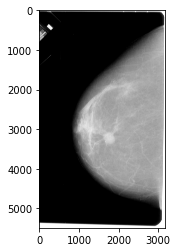

Success.
Resizing DICOM file...
Success.


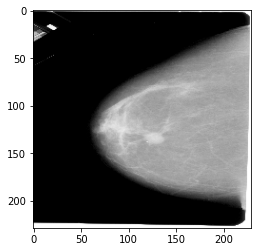

Success.
patient id is P_00074
Reading DICOM file...


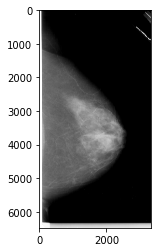

Success.
Resizing DICOM file...
Success.


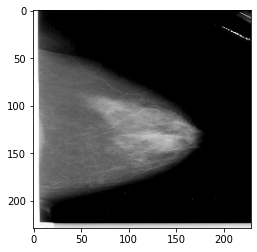

Success.
patient id is P_00328
Reading DICOM file...


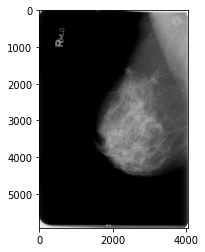

Success.
Resizing DICOM file...
Success.


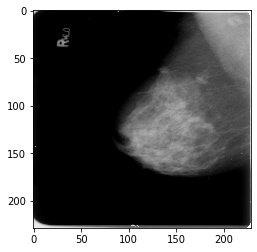

Success.
patient id is P_00235
Reading DICOM file...


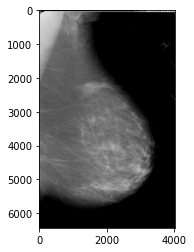

Success.
Resizing DICOM file...
Success.


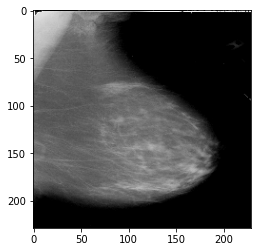

Success.
patient id is P_00309
Reading DICOM file...


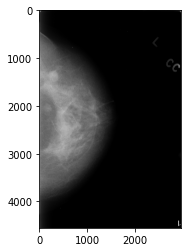

Success.
Resizing DICOM file...
Success.


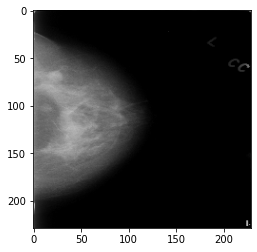

Success.
patient id is P_00221
Reading DICOM file...


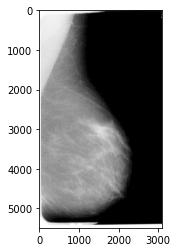

Success.
Resizing DICOM file...
Success.


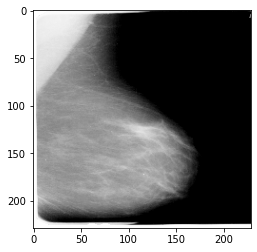

Success.
patient id is P_00106
Reading DICOM file...


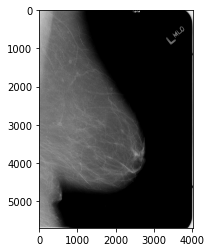

Success.
Resizing DICOM file...
Success.


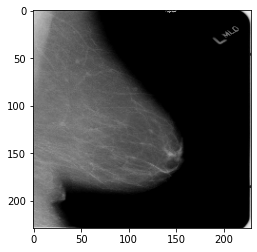

Success.
patient id is P_00177
Reading DICOM file...


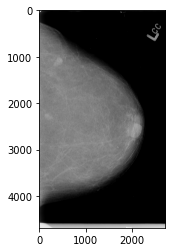

Success.
Resizing DICOM file...
Success.


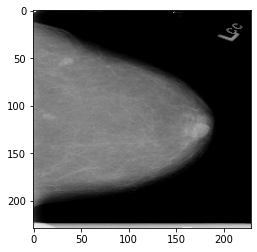

Success.
patient id is P_00379
Reading DICOM file...


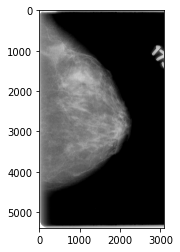

Success.
Resizing DICOM file...
Success.


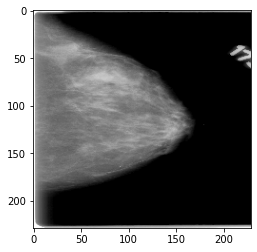

Success.
patient id is P_00200
Reading DICOM file...


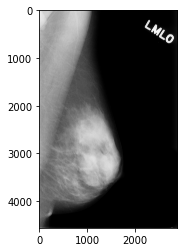

Success.
Resizing DICOM file...
Success.


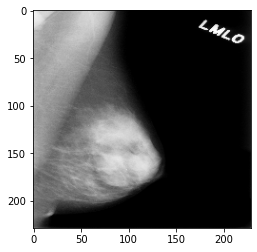

Success.
patient id is P_00544
Reading DICOM file...


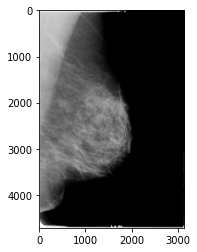

Success.
Resizing DICOM file...
Success.


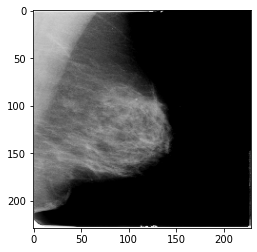

Success.
patient id is P_00173
Reading DICOM file...


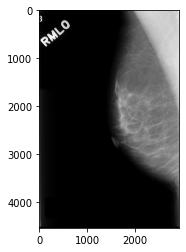

Success.
Resizing DICOM file...
Success.


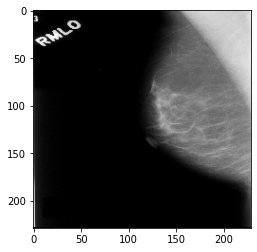

Success.
patient id is P_00369
Reading DICOM file...


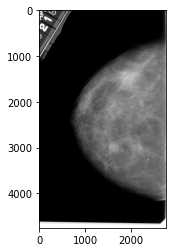

Success.
Resizing DICOM file...
Success.


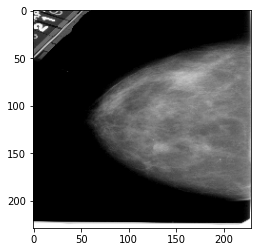

Success.
patient id is P_00405
Reading DICOM file...


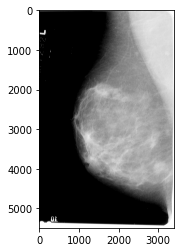

Success.
Resizing DICOM file...
Success.


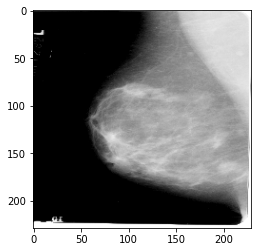

Success.
patient id is P_00662
Reading DICOM file...


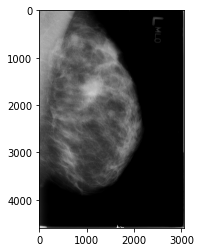

Success.
Resizing DICOM file...
Success.


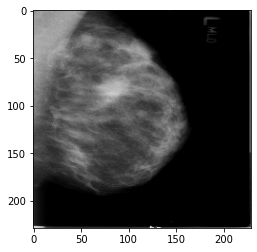

Success.
patient id is P_00490
Reading DICOM file...


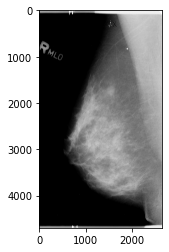

Success.
Resizing DICOM file...
Success.


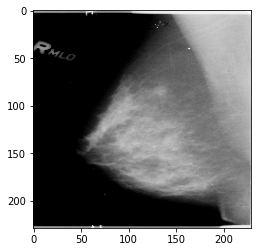

Success.
patient id is P_00533
Reading DICOM file...


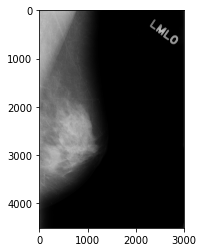

Success.
Resizing DICOM file...
Success.


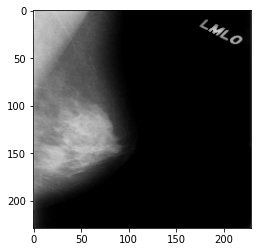

Success.
patient id is P_00409
Reading DICOM file...


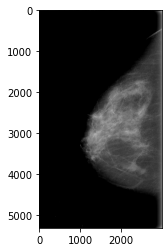

Success.
Resizing DICOM file...
Success.


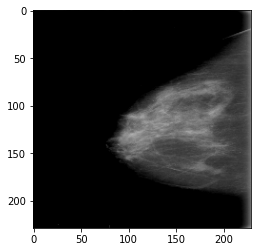

Success.
patient id is P_00615
Reading DICOM file...


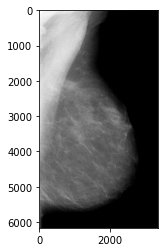

Success.
Resizing DICOM file...
Success.


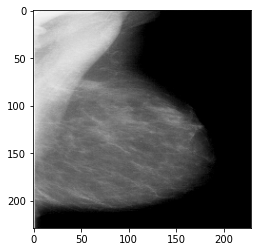

Success.
patient id is P_00524
Reading DICOM file...


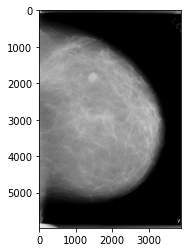

Success.
Resizing DICOM file...
Success.


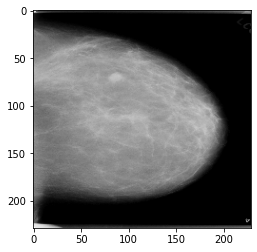

Success.
patient id is P_00016
Reading DICOM file...


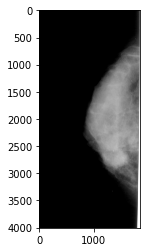

Success.
Resizing DICOM file...
Success.


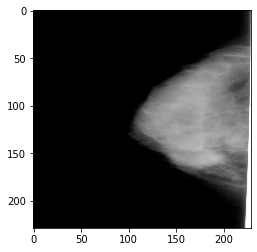

Success.
patient id is P_00766
Reading DICOM file...


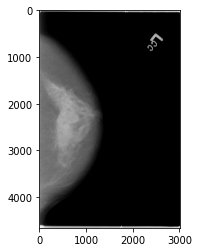

Success.
Resizing DICOM file...
Success.


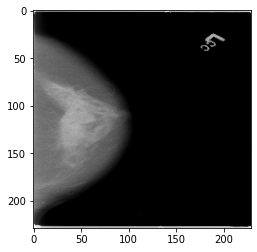

Success.
patient id is P_00391
Reading DICOM file...


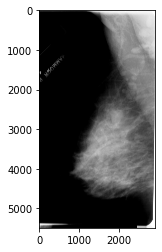

Success.
Resizing DICOM file...
Success.


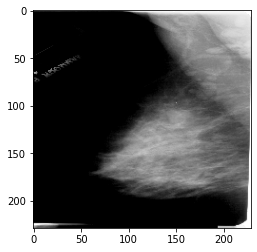

Success.
patient id is P_00369
Reading DICOM file...


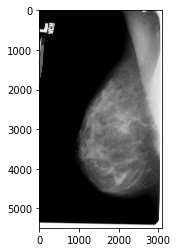

Success.
Resizing DICOM file...
Success.


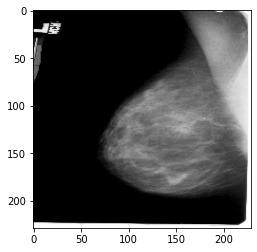

Success.
patient id is P_00066
Reading DICOM file...


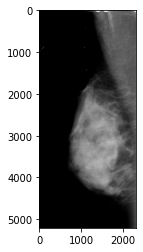

Success.
Resizing DICOM file...
Success.


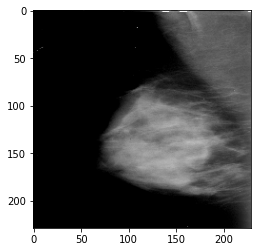

Success.
patient id is P_00238
Reading DICOM file...


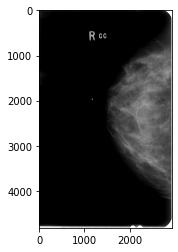

Success.
Resizing DICOM file...
Success.


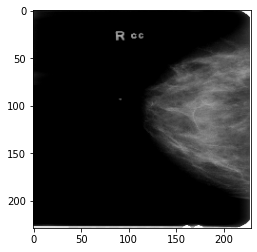

Success.
patient id is P_00490
Reading DICOM file...


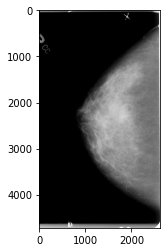

Success.
Resizing DICOM file...
Success.


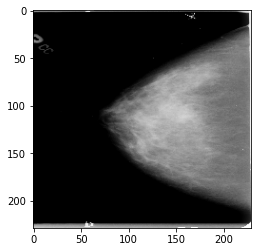

Success.
patient id is P_00510
Reading DICOM file...


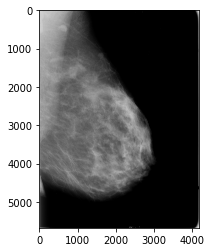

Success.
Resizing DICOM file...
Success.


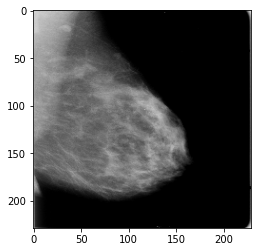

Success.
patient id is P_00652
Reading DICOM file...


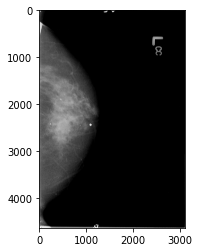

Success.
Resizing DICOM file...
Success.


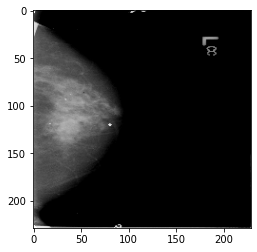

Success.
patient id is P_00738
Reading DICOM file...


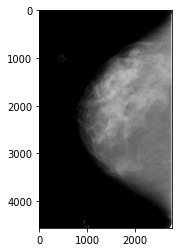

Success.
Resizing DICOM file...
Success.


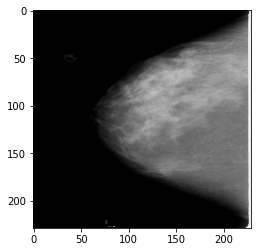

Success.
patient id is P_00758
Reading DICOM file...


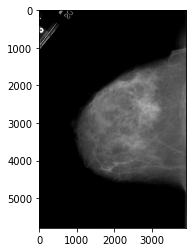

Success.
Resizing DICOM file...
Success.


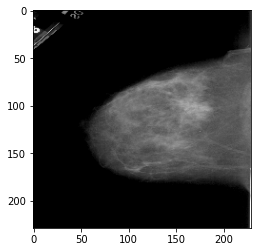

Success.
patient id is P_00131
Reading DICOM file...


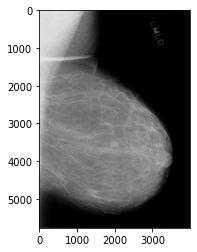

Success.
Resizing DICOM file...
Success.


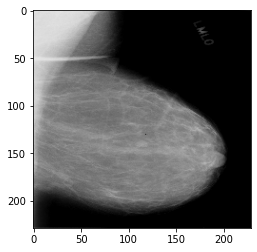

Success.
patient id is P_00343
Reading DICOM file...


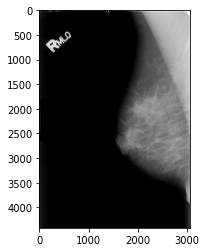

Success.
Resizing DICOM file...
Success.


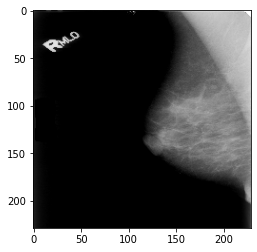

Success.
patient id is P_00017
Reading DICOM file...


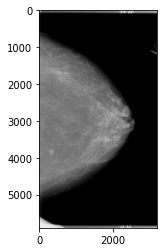

Success.
Resizing DICOM file...
Success.


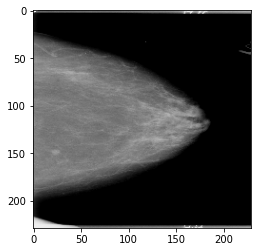

Success.
patient id is P_00707
Reading DICOM file...


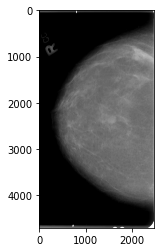

Success.
Resizing DICOM file...
Success.


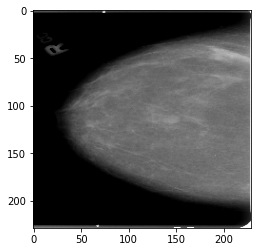

Success.
patient id is P_00230
Reading DICOM file...


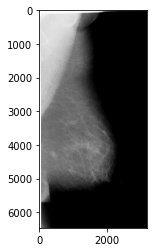

Success.
Resizing DICOM file...
Success.


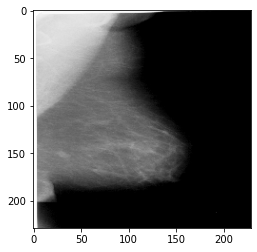

Success.
patient id is P_00524
Reading DICOM file...


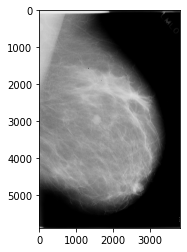

Success.
Resizing DICOM file...
Success.


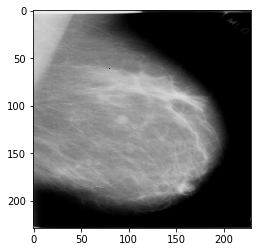

Success.
patient id is P_00159
Reading DICOM file...


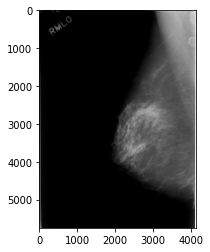

Success.
Resizing DICOM file...
Success.


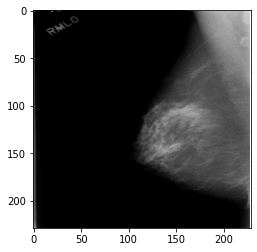

Success.
patient id is P_00347
Reading DICOM file...


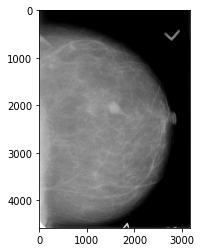

Success.
Resizing DICOM file...
Success.


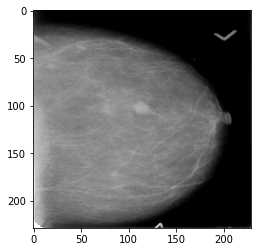

Success.
patient id is P_00409
Reading DICOM file...


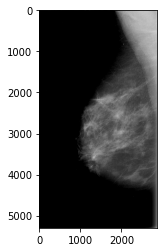

Success.
Resizing DICOM file...
Success.


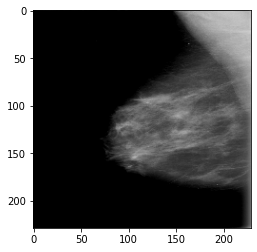

Success.
patient id is P_00200
Reading DICOM file...


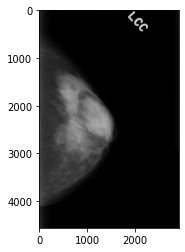

Success.
Resizing DICOM file...
Success.


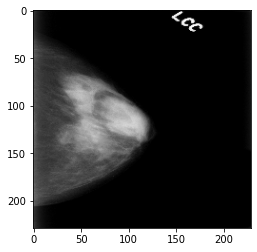

Success.
patient id is P_00741
Reading DICOM file...


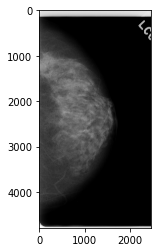

Success.
Resizing DICOM file...
Success.


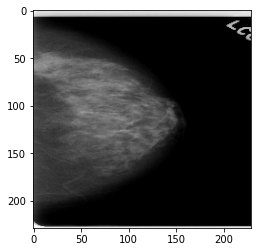

Success.
patient id is P_00296
Reading DICOM file...


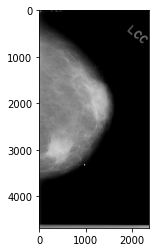

Success.
Resizing DICOM file...
Success.


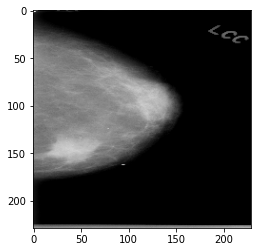

Success.
patient id is P_00387
Reading DICOM file...


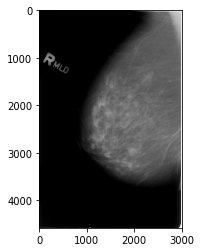

Success.
Resizing DICOM file...
Success.


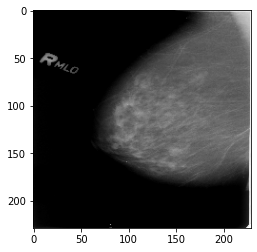

Success.
patient id is P_00173
Reading DICOM file...


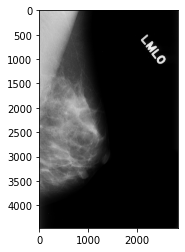

Success.
Resizing DICOM file...
Success.


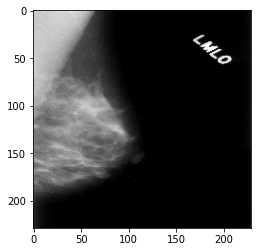

Success.
patient id is P_00116
Reading DICOM file...


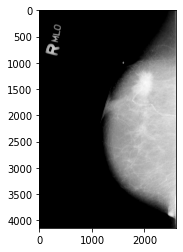

Success.
Resizing DICOM file...
Success.


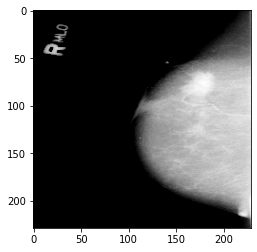

Success.
patient id is P_00500
Reading DICOM file...


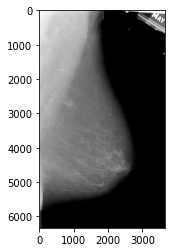

Success.
Resizing DICOM file...
Success.


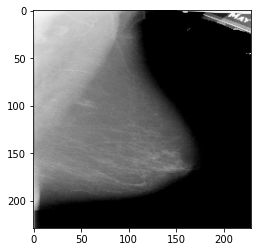

Success.
patient id is P_00173
Reading DICOM file...


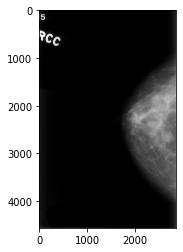

Success.
Resizing DICOM file...
Success.


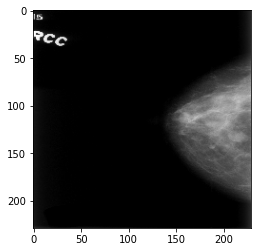

Success.
patient id is P_00387
Reading DICOM file...


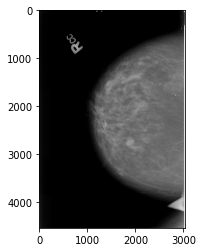

Success.
Resizing DICOM file...
Success.


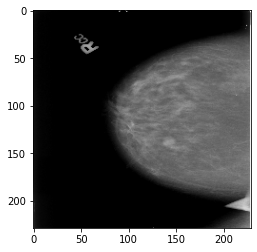

Success.
patient id is P_00202
Reading DICOM file...


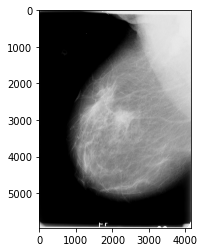

Success.
Resizing DICOM file...
Success.


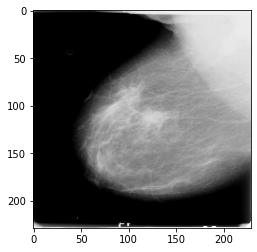

Success.
patient id is P_00464
Reading DICOM file...


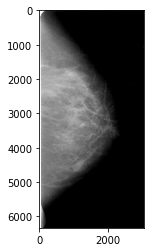

Success.
Resizing DICOM file...
Success.


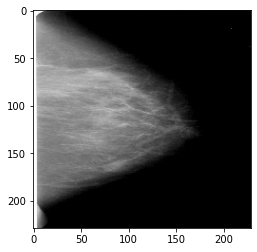

Success.
patient id is P_00147
Reading DICOM file...


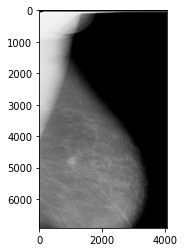

Success.
Resizing DICOM file...
Success.


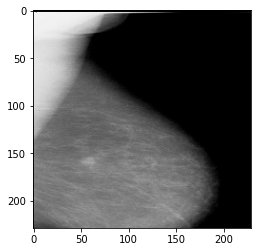

Success.
patient id is P_00544
Reading DICOM file...


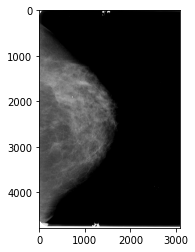

Success.
Resizing DICOM file...
Success.


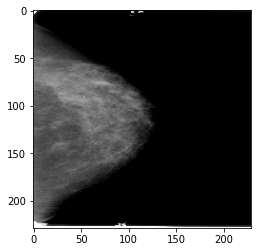

Success.
patient id is P_00636
Reading DICOM file...


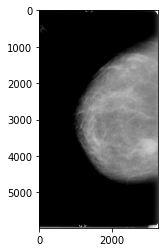

Success.
Resizing DICOM file...
Success.


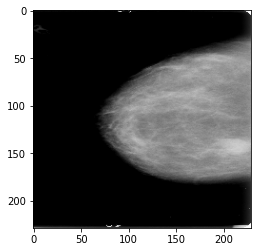

Success.
patient id is P_00641
Reading DICOM file...


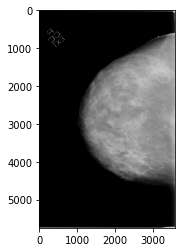

Success.
Resizing DICOM file...
Success.


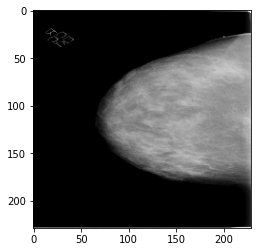

Success.
patient id is P_00032
Reading DICOM file...


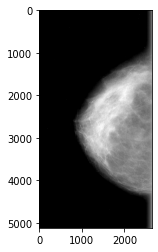

Success.
Resizing DICOM file...
Success.


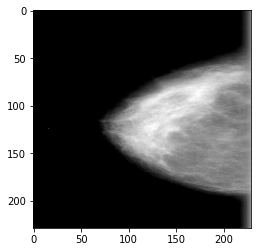

Success.
patient id is P_00278
Reading DICOM file...


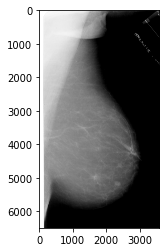

Success.
Resizing DICOM file...
Success.


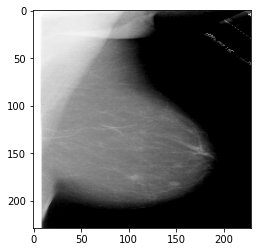

Success.
patient id is P_00510
Reading DICOM file...


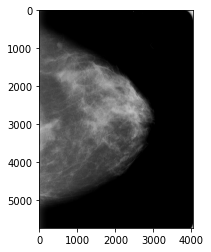

Success.
Resizing DICOM file...
Success.


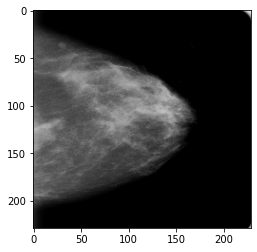

Success.
patient id is P_00381
Reading DICOM file...


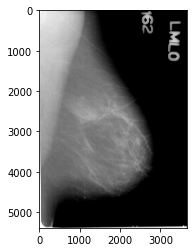

Success.
Resizing DICOM file...
Success.


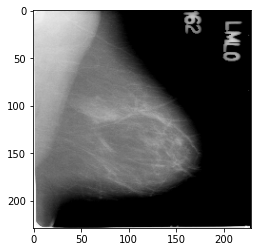

Success.
patient id is P_00099
Reading DICOM file...


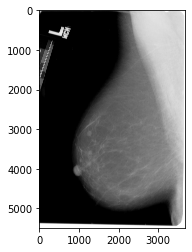

Success.
Resizing DICOM file...
Success.


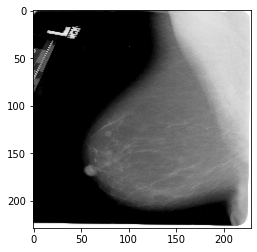

Success.
patient id is P_00457
Reading DICOM file...


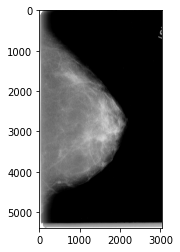

Success.
Resizing DICOM file...
Success.


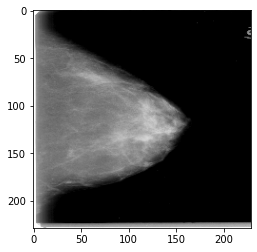

Success.
patient id is P_00656
Reading DICOM file...


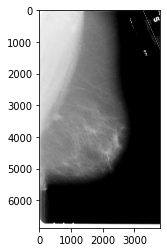

Success.
Resizing DICOM file...
Success.


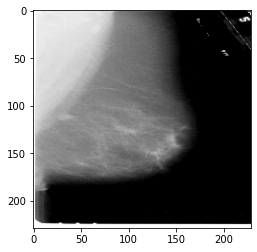

Success.
patient id is P_00147
Reading DICOM file...


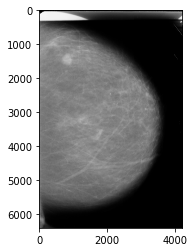

Success.
Resizing DICOM file...
Success.


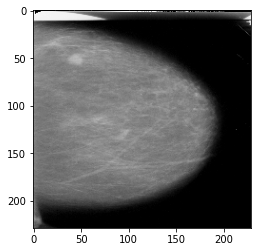

Success.
patient id is P_00457
Reading DICOM file...


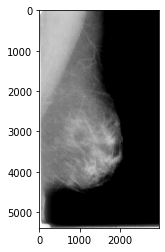

Success.
Resizing DICOM file...
Success.


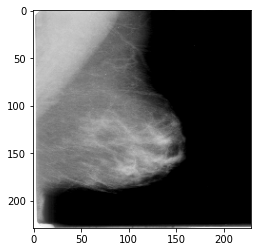

Success.
patient id is P_00677
Reading DICOM file...


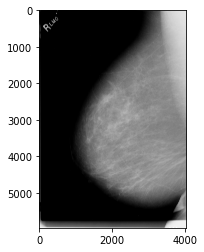

Success.
Resizing DICOM file...
Success.


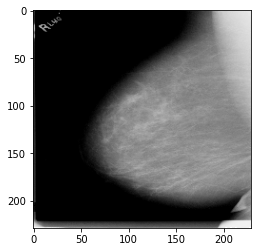

Success.
patient id is P_00394
Reading DICOM file...


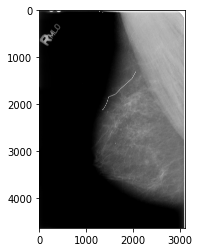

Success.
Resizing DICOM file...
Success.


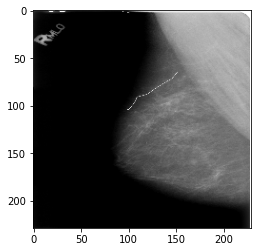

Success.
patient id is P_00516
Reading DICOM file...


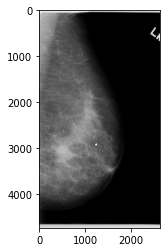

Success.
Resizing DICOM file...
Success.


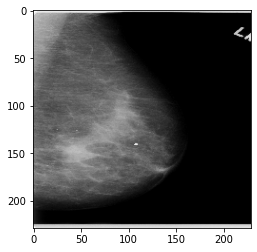

Success.
patient id is P_00391
Reading DICOM file...


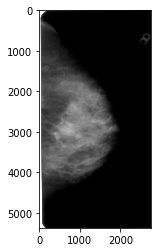

Success.
Resizing DICOM file...
Success.


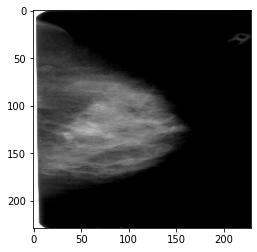

Success.
patient id is P_00612
Reading DICOM file...


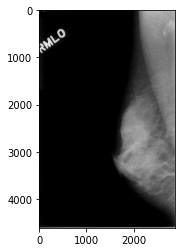

Success.
Resizing DICOM file...
Success.


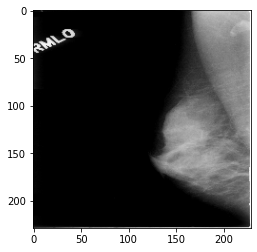

Success.
patient id is P_00598
Reading DICOM file...


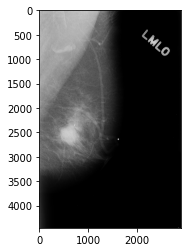

Success.
Resizing DICOM file...
Success.


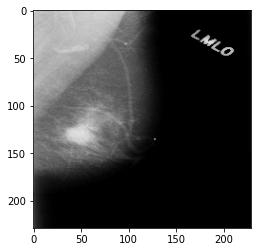

Success.
patient id is P_00017
Reading DICOM file...


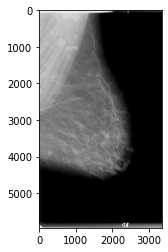

Success.
Resizing DICOM file...
Success.


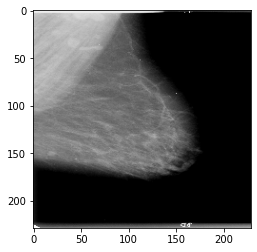

Success.
patient id is P_00203
Reading DICOM file...


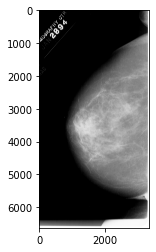

Success.
Resizing DICOM file...
Success.


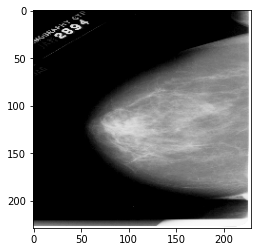

Success.
patient id is P_00481
Reading DICOM file...


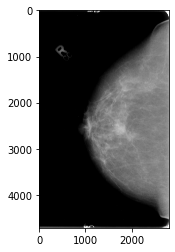

Success.
Resizing DICOM file...
Success.


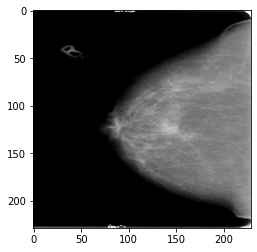

Success.
patient id is P_00016
Reading DICOM file...


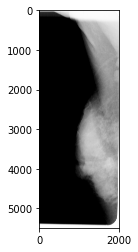

Success.
Resizing DICOM file...
Success.


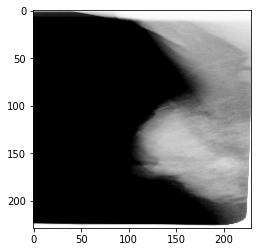

Success.
patient id is P_00379
Reading DICOM file...


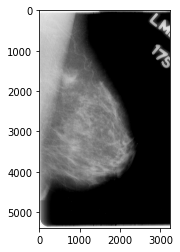

Success.
Resizing DICOM file...
Success.


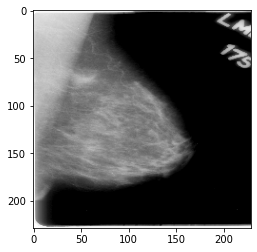

Success.
patient id is P_00032
Reading DICOM file...


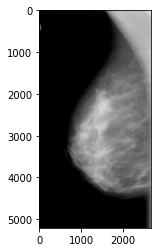

Success.
Resizing DICOM file...
Success.


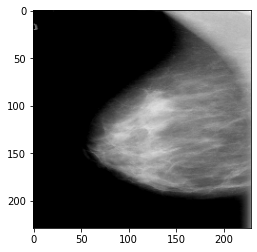

Success.
patient id is P_00375
Reading DICOM file...


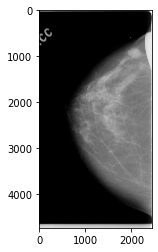

Success.
Resizing DICOM file...
Success.


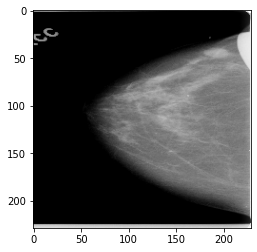

Success.
patient id is P_00126
Reading DICOM file...


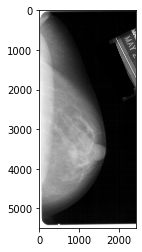

Success.
Resizing DICOM file...
Success.


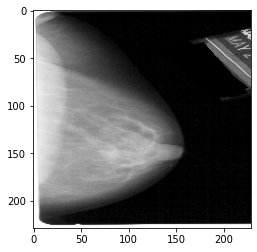

Success.
patient id is P_00576
Reading DICOM file...


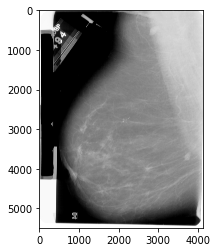

Success.
Resizing DICOM file...
Success.


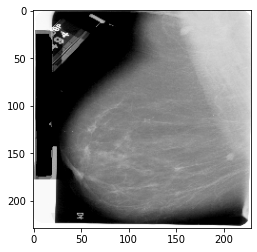

Success.
patient id is P_00623
Reading DICOM file...


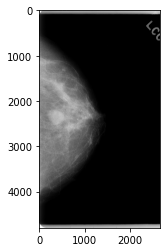

Success.
Resizing DICOM file...
Success.


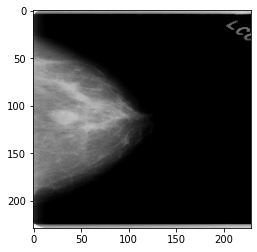

Success.
patient id is P_00114
Reading DICOM file...


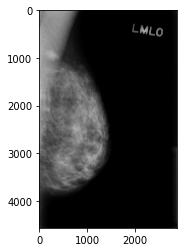

Success.
Resizing DICOM file...
Success.


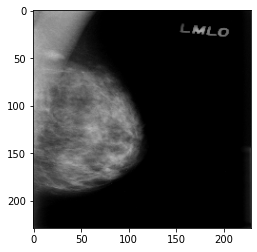

Success.
patient id is P_00587
Reading DICOM file...


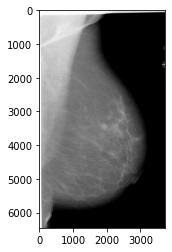

Success.
Resizing DICOM file...
Success.


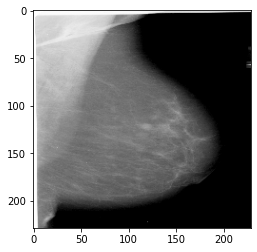

Success.
patient id is P_00066
Reading DICOM file...


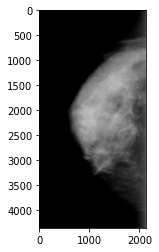

Success.
Resizing DICOM file...
Success.


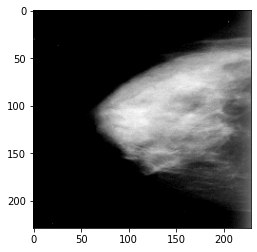

Success.
patient id is P_00615
Reading DICOM file...


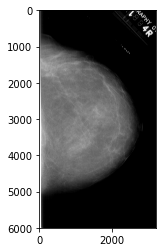

Success.
Resizing DICOM file...
Success.


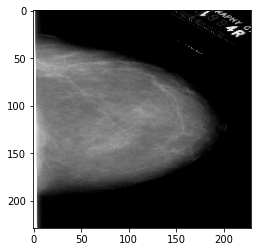

Success.
patient id is P_00347
Reading DICOM file...


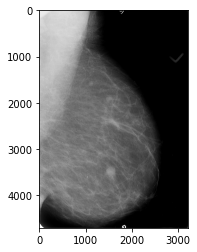

Success.
Resizing DICOM file...
Success.


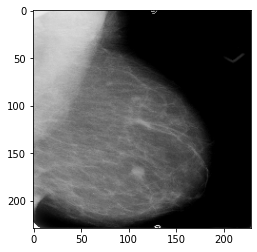

Success.
patient id is P_00766
Reading DICOM file...


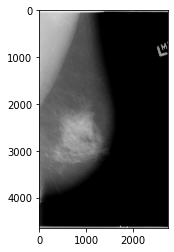

Success.
Resizing DICOM file...
Success.


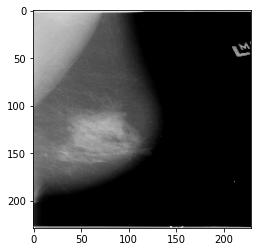

Success.
patient id is P_00200
Reading DICOM file...


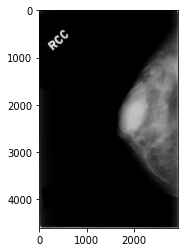

Success.
Resizing DICOM file...
Success.


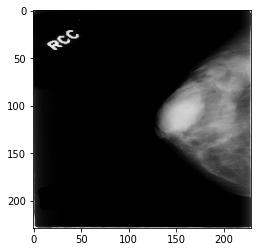

Success.
patient id is P_00636
Reading DICOM file...


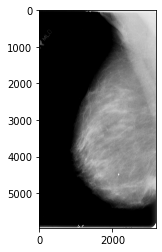

Success.
Resizing DICOM file...
Success.


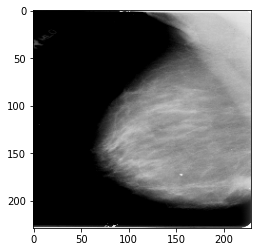

Success.
patient id is P_00037
Reading DICOM file...


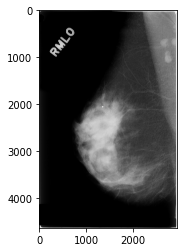

Success.
Resizing DICOM file...
Success.


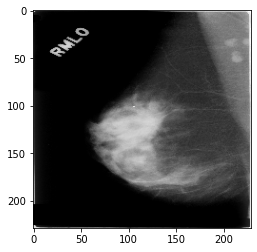

Success.
patient id is P_00118
Reading DICOM file...


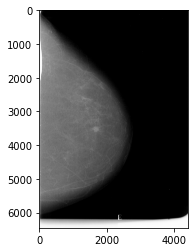

Success.
Resizing DICOM file...
Success.


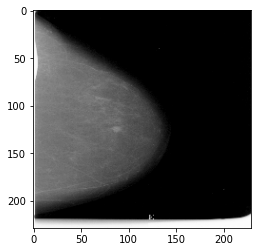

Success.
patient id is P_00699
Reading DICOM file...


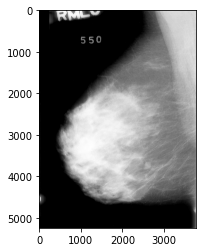

Success.
Resizing DICOM file...
Success.


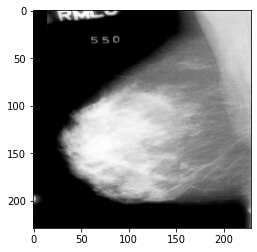

Success.
patient id is P_00758
Reading DICOM file...


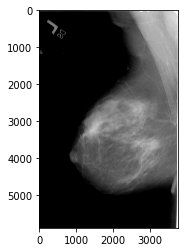

Success.
Resizing DICOM file...
Success.


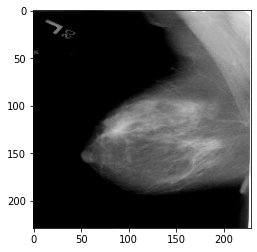

Success.
patient id is P_00171
Reading DICOM file...


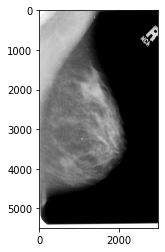

Success.
Resizing DICOM file...
Success.


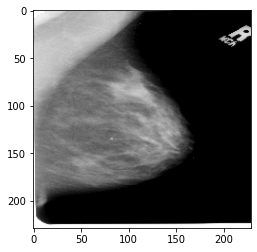

Success.
patient id is P_00131
Reading DICOM file...


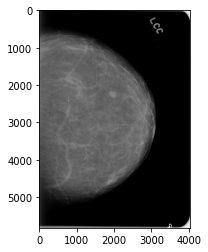

Success.
Resizing DICOM file...
Success.


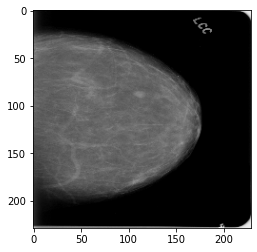

Success.
patient id is P_00212
Reading DICOM file...


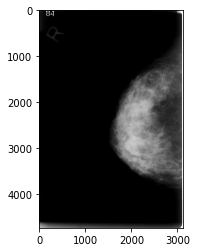

Success.
Resizing DICOM file...
Success.


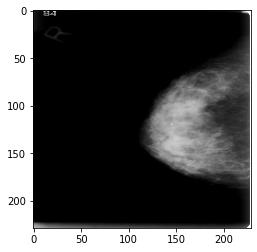

Success.
patient id is P_00198
Reading DICOM file...


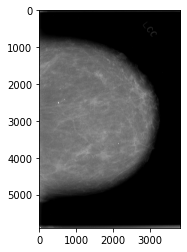

Success.
Resizing DICOM file...
Success.


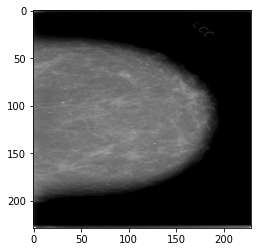

Success.
patient id is P_00158
Reading DICOM file...


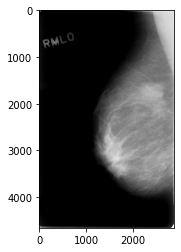

Success.
Resizing DICOM file...
Success.


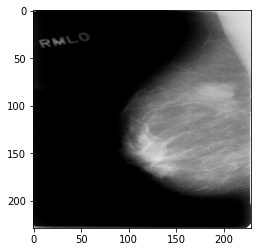

Success.
patient id is P_00587
Reading DICOM file...


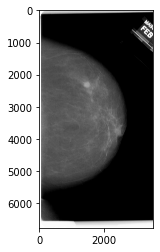

Success.
Resizing DICOM file...
Success.


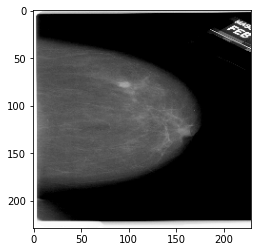

Success.
patient id is P_00576
Reading DICOM file...


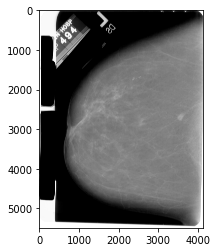

Success.
Resizing DICOM file...
Success.


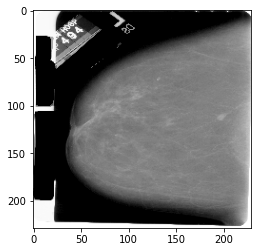

Success.
patient id is P_00662
Reading DICOM file...


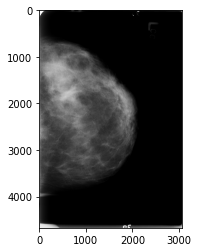

Success.
Resizing DICOM file...
Success.


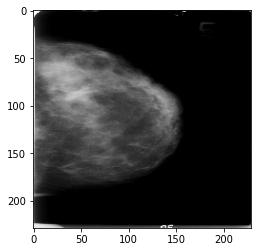

Success.
patient id is P_00358
Reading DICOM file...


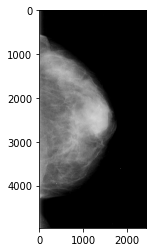

Success.
Resizing DICOM file...
Success.


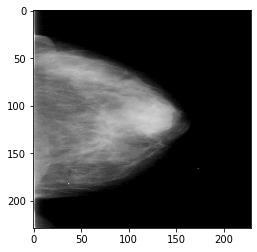

Success.
patient id is P_00324
Reading DICOM file...


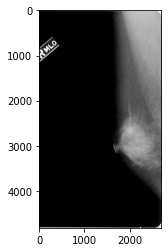

Success.
Resizing DICOM file...
Success.


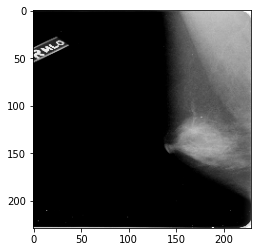

Success.
patient id is P_00482
Reading DICOM file...


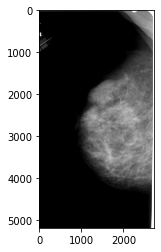

Success.
Resizing DICOM file...
Success.


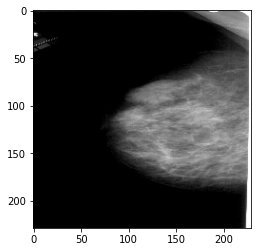

Success.
patient id is P_00145
Reading DICOM file...


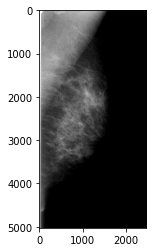

Success.
Resizing DICOM file...
Success.


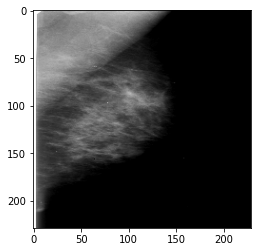

Success.
patient id is P_00324
Reading DICOM file...


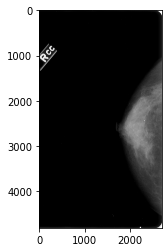

Success.
Resizing DICOM file...
Success.


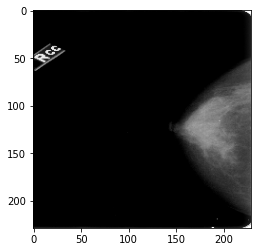

Success.
patient id is P_00601
Reading DICOM file...


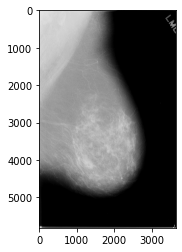

Success.
Resizing DICOM file...
Success.


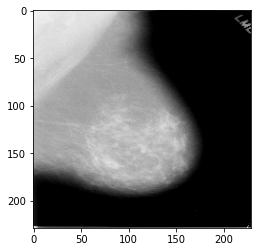

Success.
patient id is P_00037
Reading DICOM file...


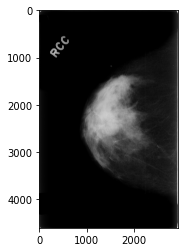

Success.
Resizing DICOM file...
Success.


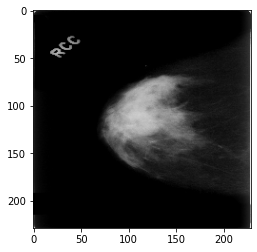

Success.
patient id is P_00601
Reading DICOM file...


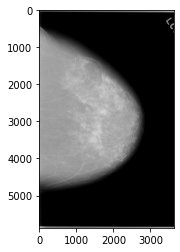

Success.
Resizing DICOM file...
Success.


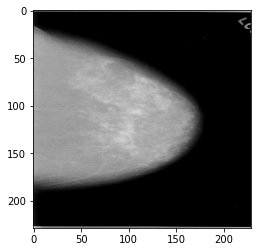

Success.
patient id is P_00498
Reading DICOM file...


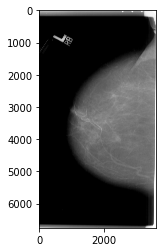

Success.
Resizing DICOM file...
Success.


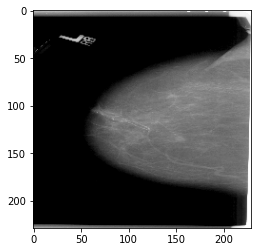

Success.
patient id is P_00194
Reading DICOM file...


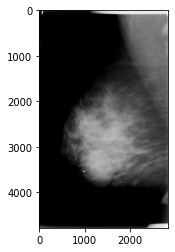

Success.
Resizing DICOM file...
Success.


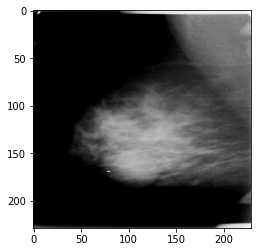

Success.
patient id is P_00192
Reading DICOM file...


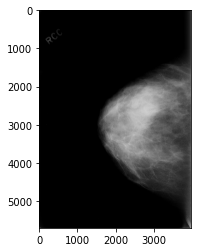

Success.
Resizing DICOM file...
Success.


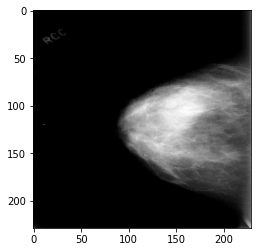

Success.
patient id is P_00623
Reading DICOM file...


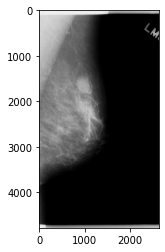

Success.
Resizing DICOM file...
Success.


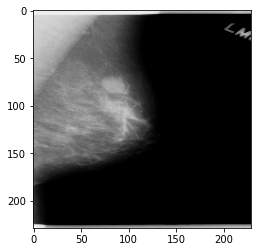

Success.
patient id is P_00718
Reading DICOM file...


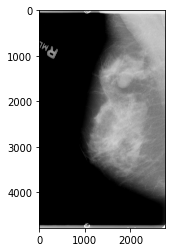

Success.
Resizing DICOM file...
Success.


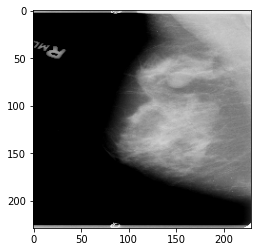

Success.
patient id is P_00340
Reading DICOM file...


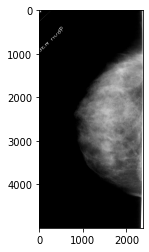

Success.
Resizing DICOM file...
Success.


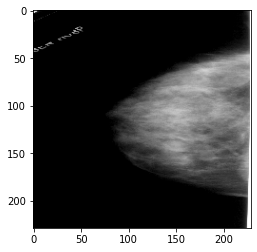

Success.
patient id is P_00741
Reading DICOM file...


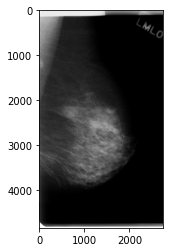

Success.
Resizing DICOM file...
Success.


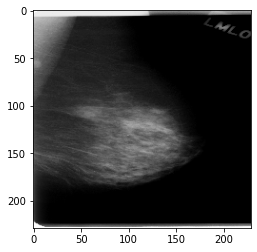

Success.
patient id is P_00707
Reading DICOM file...


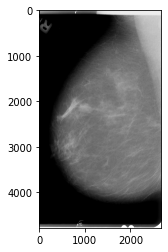

Success.
Resizing DICOM file...
Success.


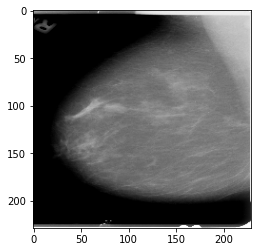

Success.
patient id is P_00641
Reading DICOM file...


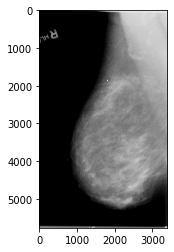

Success.
Resizing DICOM file...
Success.


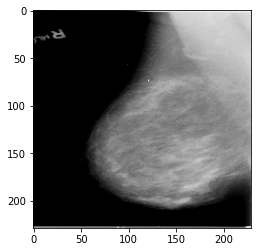

Success.
patient id is P_00429
Reading DICOM file...


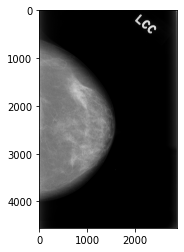

Success.
Resizing DICOM file...
Success.


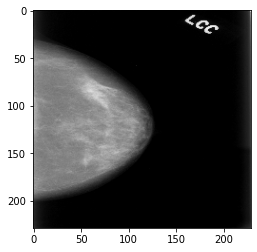

Success.
patient id is P_00278
Reading DICOM file...


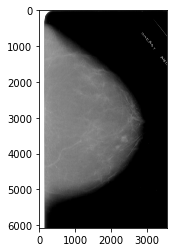

Success.
Resizing DICOM file...
Success.


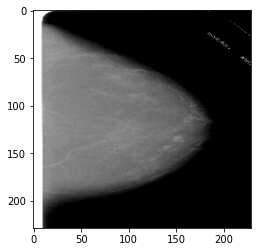

Success.
patient id is P_00493
Reading DICOM file...


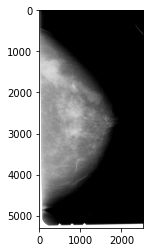

Success.
Resizing DICOM file...
Success.


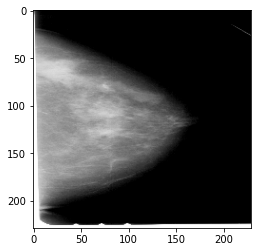

Success.
patient id is P_00494
Reading DICOM file...


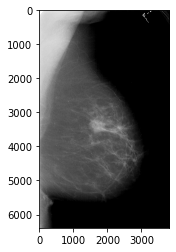

Success.
Resizing DICOM file...
Success.


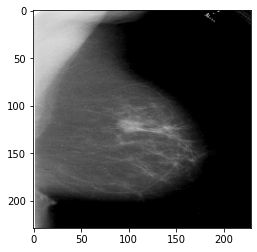

Success.
patient id is P_00203
Reading DICOM file...


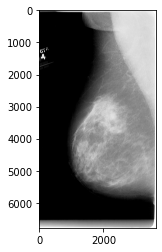

Success.
Resizing DICOM file...
Success.


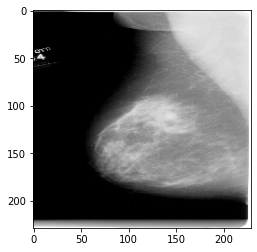

Success.
patient id is P_00156
Reading DICOM file...


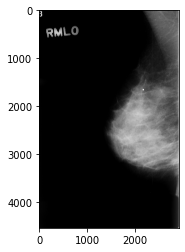

Success.
Resizing DICOM file...
Success.


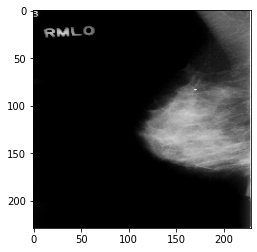

Success.
patient id is P_00209
Reading DICOM file...


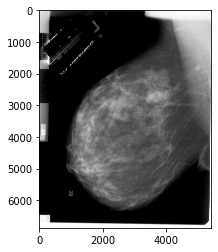

Success.
Resizing DICOM file...
Success.


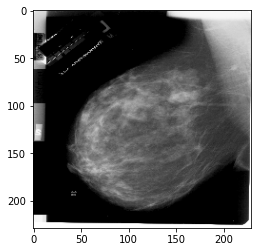

Success.
patient id is P_00433
Reading DICOM file...


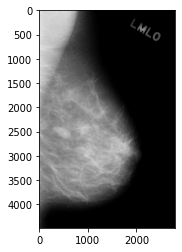

Success.
Resizing DICOM file...
Success.


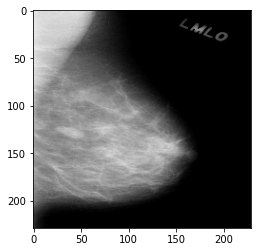

Success.
patient id is P_00629
Reading DICOM file...


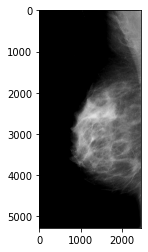

Success.
Resizing DICOM file...
Success.


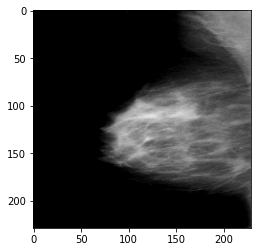

Success.
patient id is P_00116
Reading DICOM file...


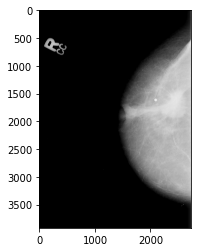

Success.
Resizing DICOM file...
Success.


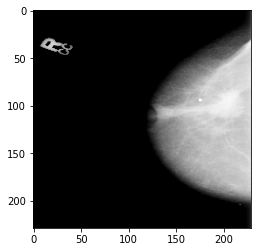

Success.
patient id is P_00056
Reading DICOM file...


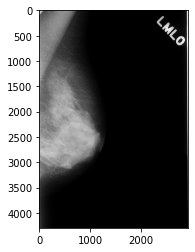

Success.
Resizing DICOM file...
Success.


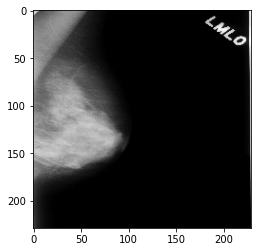

Success.
patient id is P_00202
Reading DICOM file...


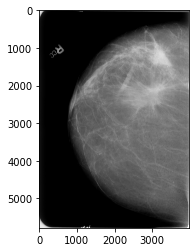

Success.
Resizing DICOM file...
Success.


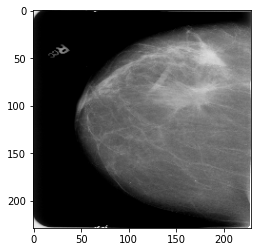

Success.
patient id is P_00470
Reading DICOM file...


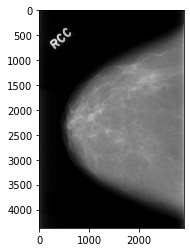

Success.
Resizing DICOM file...
Success.


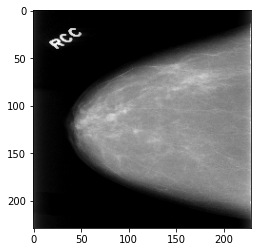

Success.
patient id is P_00391
Reading DICOM file...


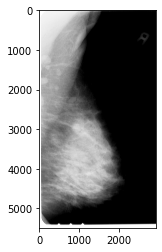

Success.
Resizing DICOM file...
Success.


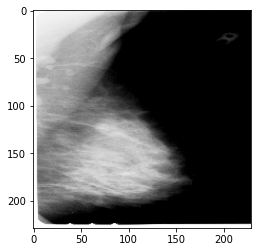

Success.
patient id is P_00343
Reading DICOM file...


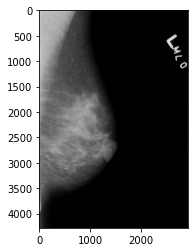

Success.
Resizing DICOM file...
Success.


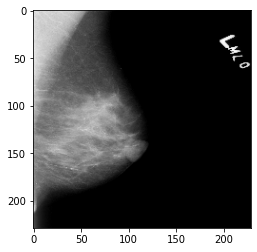

Success.
patient id is P_00230
Reading DICOM file...


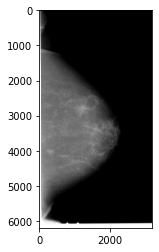

Success.
Resizing DICOM file...
Success.


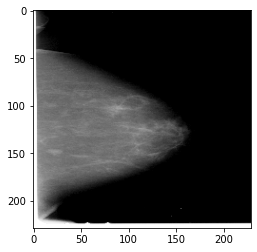

Success.
patient id is P_00358
Reading DICOM file...


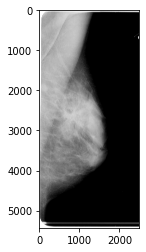

Success.
Resizing DICOM file...
Success.


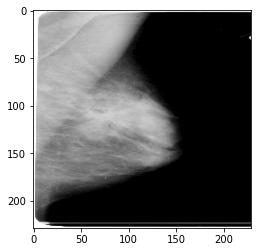

Success.
patient id is P_00200
Reading DICOM file...


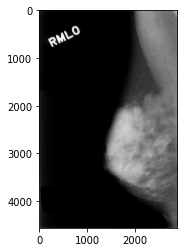

Success.
Resizing DICOM file...
Success.


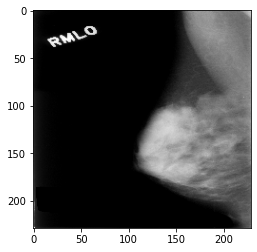

Success.
patient id is P_00533
Reading DICOM file...


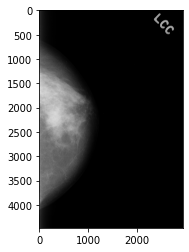

Success.
Resizing DICOM file...
Success.


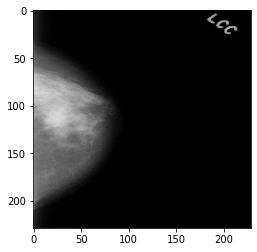

Success.
patient id is P_00498
Reading DICOM file...


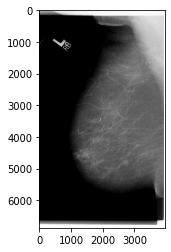

Success.
Resizing DICOM file...
Success.


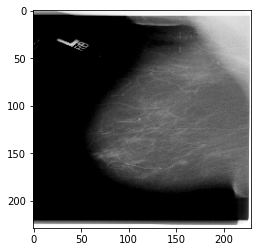

Success.
patient id is P_00671
Reading DICOM file...


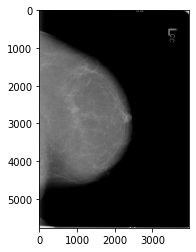

Success.
Resizing DICOM file...
Success.


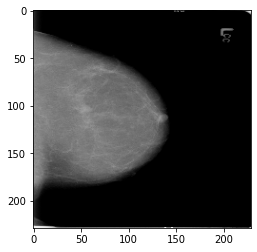

Success.
patient id is P_00173
Reading DICOM file...


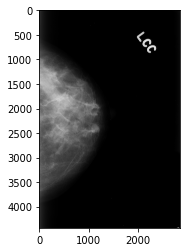

Success.
Resizing DICOM file...
Success.


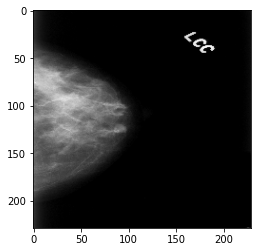

Success.
patient id is P_00494
Reading DICOM file...


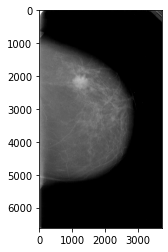

Success.
Resizing DICOM file...
Success.


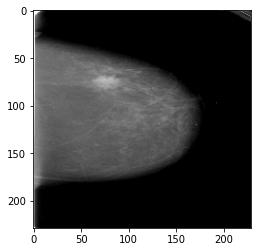

Success.
patient id is P_00145
Reading DICOM file...


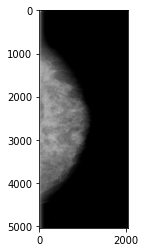

Success.
Resizing DICOM file...
Success.


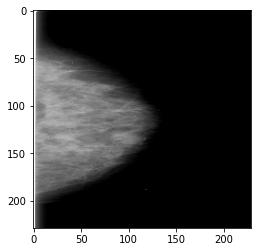

Success.
patient id is P_00343
Reading DICOM file...


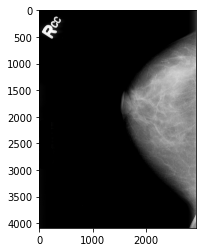

Success.
Resizing DICOM file...
Success.


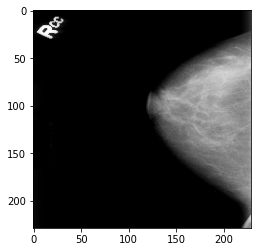

Success.
patient id is P_00598
Reading DICOM file...


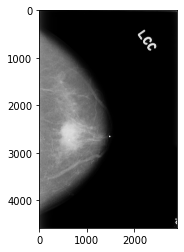

Success.
Resizing DICOM file...
Success.


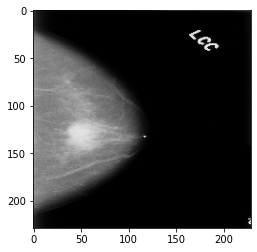

Success.
patient id is P_00629
Reading DICOM file...


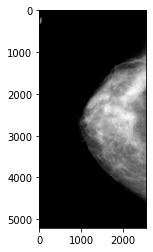

Success.
Resizing DICOM file...
Success.


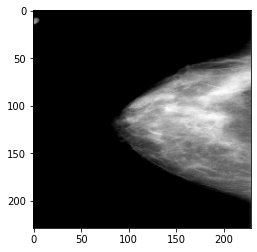

Success.
patient id is P_00124
Reading DICOM file...


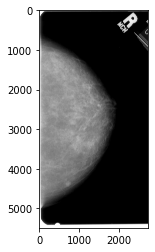

Success.
Resizing DICOM file...
Success.


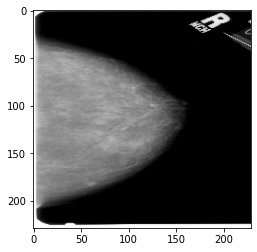

Success.
patient id is P_00126
Reading DICOM file...


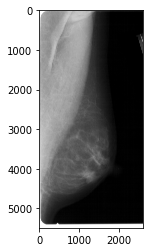

Success.
Resizing DICOM file...
Success.


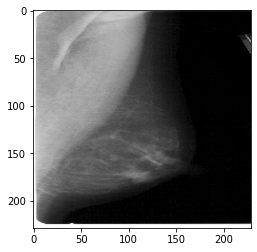

Success.
patient id is P_00296
Reading DICOM file...


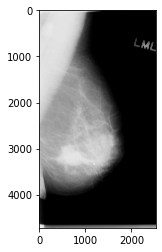

Success.
Resizing DICOM file...
Success.


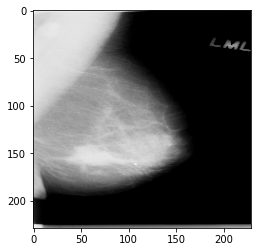

Success.
patient id is P_00391
Reading DICOM file...


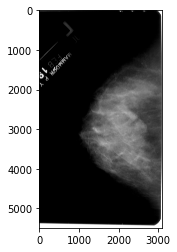

Success.
Resizing DICOM file...
Success.


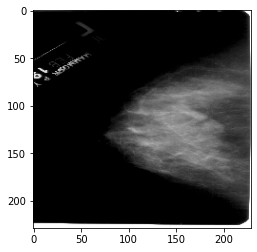

Success.
patient id is P_00177
Reading DICOM file...


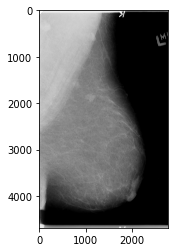

Success.
Resizing DICOM file...
Success.


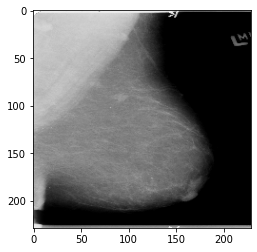

Success.
patient id is P_00375
Reading DICOM file...


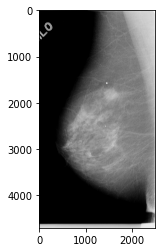

Success.
Resizing DICOM file...
Success.


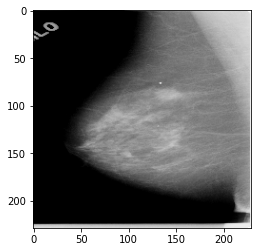

Success.
patient id is P_00773
Reading DICOM file...


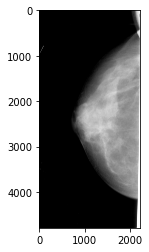

Success.
Resizing DICOM file...
Success.


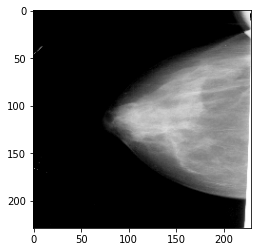

Success.
patient id is P_00514
Reading DICOM file...


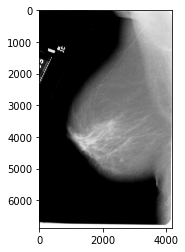

Success.
Resizing DICOM file...
Success.


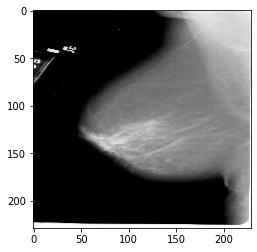

Success.
patient id is P_00482
Reading DICOM file...


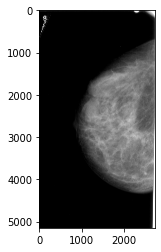

Success.
Resizing DICOM file...
Success.


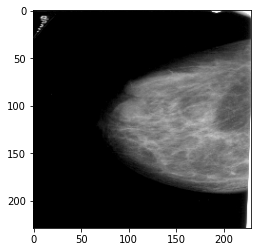

Success.
patient id is P_00238
Reading DICOM file...


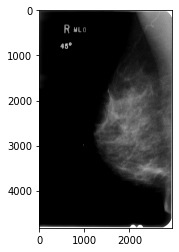

Success.
Resizing DICOM file...
Success.


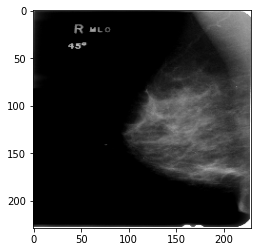

Success.
patient id is P_00481
Reading DICOM file...


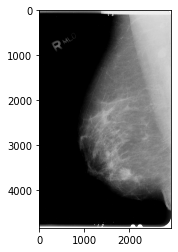

Success.
Resizing DICOM file...
Success.


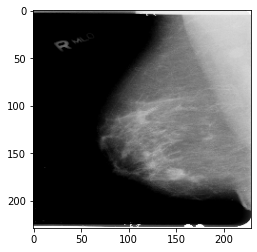

Success.
patient id is P_00381
Reading DICOM file...


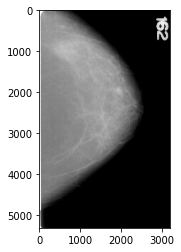

Success.
Resizing DICOM file...
Success.


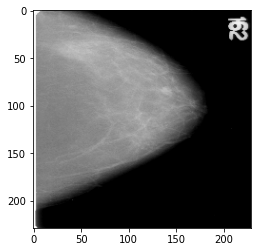

Success.
patient id is P_00405
Reading DICOM file...


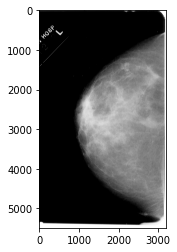

Success.
Resizing DICOM file...
Success.


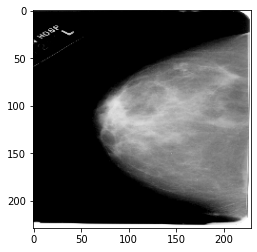

Success.
patient id is P_00118
Reading DICOM file...


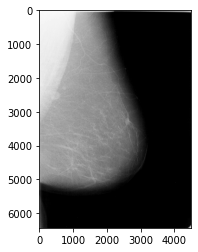

Success.
Resizing DICOM file...
Success.


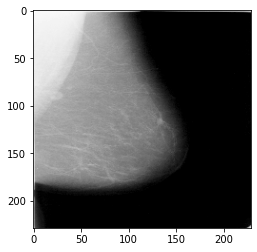

Success.
patient id is P_00677
Reading DICOM file...


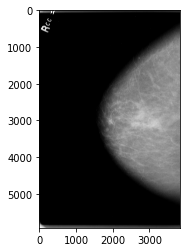

Success.
Resizing DICOM file...
Success.


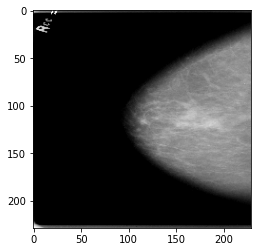

Success.
patient id is P_00470
Reading DICOM file...


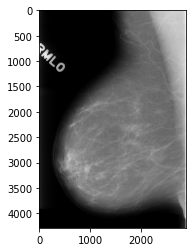

Success.
Resizing DICOM file...
Success.


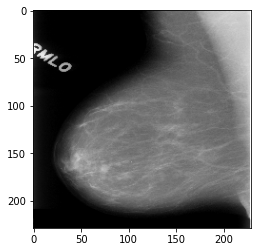

Success.
patient id is P_00699
Reading DICOM file...


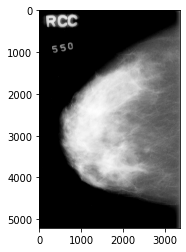

Success.
Resizing DICOM file...
Success.


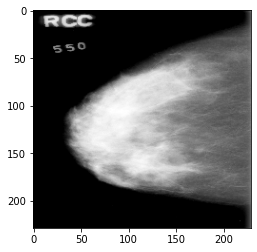

Success.
patient id is P_00738
Reading DICOM file...


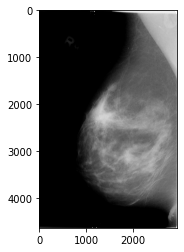

Success.
Resizing DICOM file...
Success.


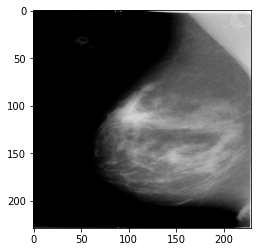

Success.
patient id is P_00359
Reading DICOM file...


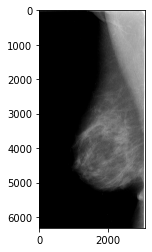

Success.
Resizing DICOM file...
Success.


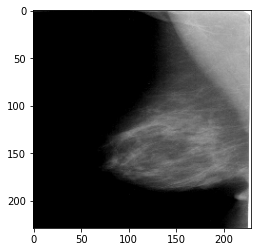

Success.
patient id is P_00639
Reading DICOM file...


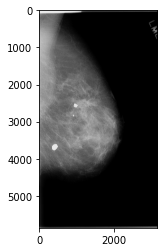

Success.
Resizing DICOM file...
Success.


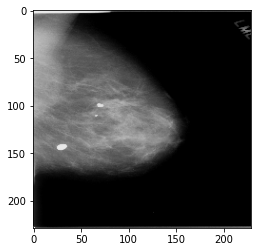

Success.
patient id is P_00171
Reading DICOM file...


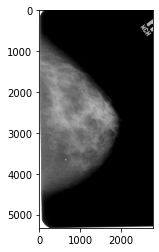

Success.
Resizing DICOM file...
Success.


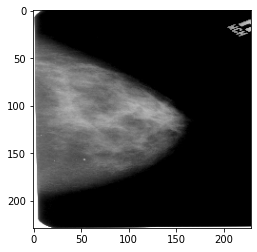

Success.
patient id is P_00198
Reading DICOM file...


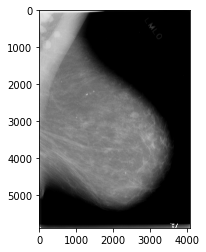

Success.
Resizing DICOM file...
Success.


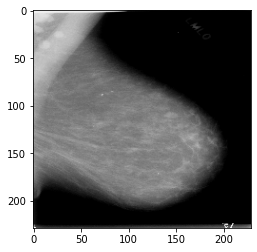

Success.
patient id is P_00212
Reading DICOM file...


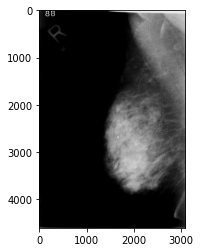

Success.
Resizing DICOM file...
Success.


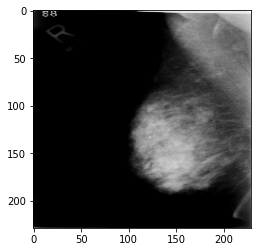

Success.
patient id is P_00343
Reading DICOM file...


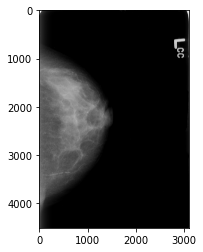

Success.
Resizing DICOM file...
Success.


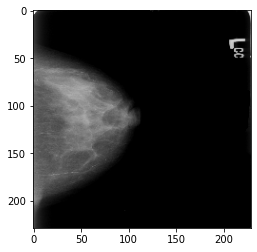

Success.
patient id is P_00591
Reading DICOM file...


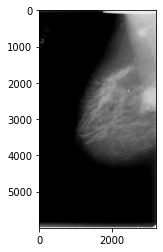

Success.
Resizing DICOM file...
Success.


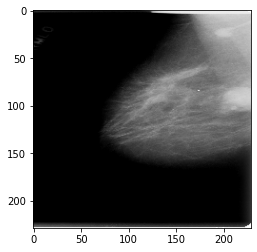

Success.
patient id is P_00516
Reading DICOM file...


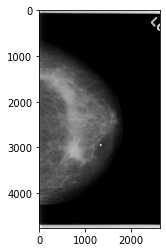

Success.
Resizing DICOM file...
Success.


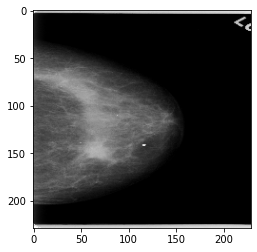

Success.
patient id is P_00194
Reading DICOM file...


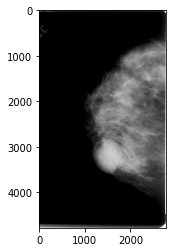

Success.
Resizing DICOM file...
Success.


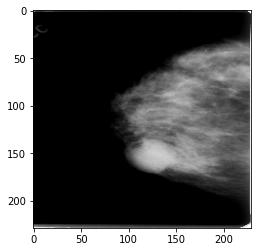

Success.
patient id is P_00464
Reading DICOM file...


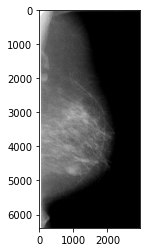

Success.
Resizing DICOM file...
Success.


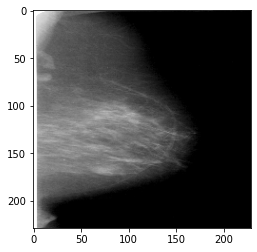

Success.
patient id is P_00429
Reading DICOM file...


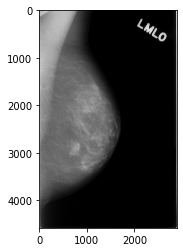

Success.
Resizing DICOM file...
Success.


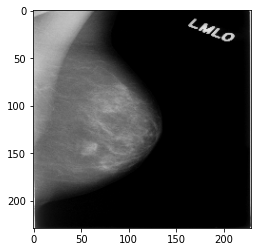

Success.
patient id is P_00433
Reading DICOM file...


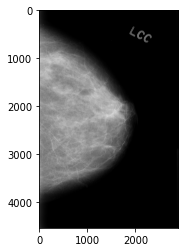

Success.
Resizing DICOM file...
Success.


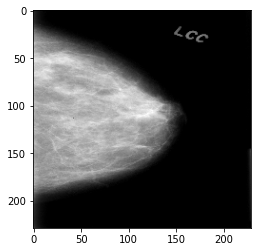

Success.
patient id is P_00671
Reading DICOM file...


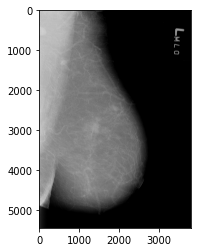

Success.
Resizing DICOM file...
Success.


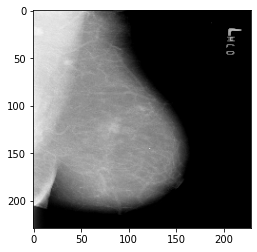

Success.


In [20]:
# pdm.config.debug()
dir_path = os.getcwd()
train_data, train_labels, test_data, test_labels = main(dir_path, verbose=True)

# **Part 2: Machine Learning**

In [21]:
train_data = np.asarray(train_data)
print("train data shape: ", train_data.shape) # (250, 299, 299)
train_data = tf.convert_to_tensor(train_data)
train_labels = np.asarray(train_labels)
print("train labels shape: ", train_labels.shape) # (250,)

test_data = np.asarray(test_data)
print("test data shape: ", test_data.shape) # (168, 299, 299)
test_data = tf.convert_to_tensor(test_data)
test_labels = np.asarray(test_labels)
print("test labels shape: ", test_labels.shape) # (168,)

train data shape:  (250, 229, 229)
train labels shape:  (250,)
test data shape:  (168, 229, 229)
test labels shape:  (168,)


In [22]:
train_dataset = tf.data.Dataset.from_tensor_slices((train_data, train_labels))
test_dataset = tf.data.Dataset.from_tensor_slices((test_data, test_labels))

In [23]:
batch_size = 5
shuffle_buffer_size = 50
train_dataset = train_dataset.shuffle(shuffle_buffer_size).batch(batch_size)
test_dataset = test_dataset.batch(batch_size)

# print("train dataset contains: ")
# for element in train_dataset.as_numpy_iterator():
#   print(element)
# print("test dataset contains: ")
# for element in train_dataset.as_numpy_iterator():
#   print(element)

Epoch 1/10

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

50/50 [==============================] - 1s 27ms/step - loss: 0.6603 - sparse_categorical_accuracy: 0.6440
Epoch 2/10
50/50 [==============================] - 1s 28ms/step - loss: 0.6488 - sparse_categorical_accuracy: 0.6600
Epoch 3/10
50/50 [==============================] - 1s 28ms/step - loss: 0.6528 - sparse_categorical_accuracy: 0.6600
Epoch 4/10
50/50 [==============================] - 1s 27ms/step - loss: 0.6386 - sparse_categorical_accuracy: 0.6560
Epoch 5/10
50/50 [==================

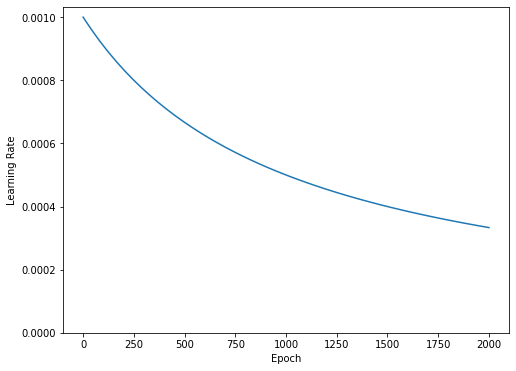

In [26]:
###########################
# Citation: from tensorflow.org
steps_per_epoch = 250/batch_size

lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
                    0.001,
                    decay_steps=steps_per_epoch*1000,
                    decay_rate=1,
                    staircase=False)

def get_optimizer():
  return tf.keras.optimizers.Adam(lr_schedule)

step = np.linspace(0,100000)
lr = lr_schedule(step)
plt.figure(figsize = (8,6))
plt.plot(step/steps_per_epoch, lr)
plt.ylim([0,max(plt.ylim())])
plt.xlabel('Epoch')
_ = plt.ylabel('Learning Rate')
###########################

model = tf.keras.Sequential([
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(128, activation='relu'),
            tf.keras.layers.Dense(64, activation='tanh'),
            tf.keras.layers.Dense(32, activation='sigmoid'),
            tf.keras.layers.Dense(2)
])

model.compile(optimizer=get_optimizer(),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['sparse_categorical_accuracy'])

model.fit(train_dataset, epochs=10)
result = model.predict(test_dataset, steps=10)
print(result.shape) # (50, 2)
print(result)

In [ ]:
# confusion matrix: https://en.wikipedia.org/wiki/Confusion_matrix
##################################################
##                 actual 0         actual 1    ##
## predicted  0 true_zero (TP)  false_zero (FP) ##
## predicted  1 false_one (FN)  true_one (TN)   ##
##################################################

actual = test_labels
predicted = result
true_zero = 0
true_one = 0
false_one = 0
false_zero = 0
for i in range(168):
  if actual[i] == predicted[i]:
    if actual[i] == 0:
      true_zero += 1
    else:
      true_one += 1
  else:
    if actual[i] == 0 and predicted[i] == 1:
      false_one += 1
    else:
      false_zero += 1

data = { "actual 0" : [true_zero, false_one], "actual 1" : [false_zero, true_one]}
confusion_matrix = pd.DataFrame(data, index=["predicted 0", "predicted 1"])
print(confusion_matrix)

In [ ]:
# ROC curve: https://developers.google.com/machine-learning/crash-course/classification/roc-and-auc#:~:text=An%20ROC%20curve%20(receiver%20operating,False%20Positive%20Rate
true_pos_rate = true_zero / (true_zero + false_one)
false_pos_rate = false_zero / (false_zero + true_one)




# **Documentation**

**`resize_image(filepath, custom_shape, show=True, verbose=False)`**
*   Inputs 
  * FILEPATH: string path of image file to resize
  * CUSTOM_SHAPE: tuple of resized dimensions (e.g. (299, 299))
  * [SHOW=True]: plot image before and after resizing
  * [VERBOSE=False]: do not print intermediate progress
*   Outputs
  1. if DICOM, dataframe; if PNG, original image numpy array
  2. resized array
*  Functionality
  * Resizes input image file to custom dimension and returns the original dataframe or image array and the resized array. 


**`save_to_npy(filepath, arr_data, verbose=False)`**
*   Inputs
  * FILEPATH: desired numpy filepath string (no extensions)
  * ARR_DATA: numpy array to save in the numpy file
  * [VERBOSE=False]: do not print intermediate progress
*   Outputs
  1. NPY_PATH: the full numpy filepath (with .npy extension)
*   Functionality
  * Saves input data to a numpy file using the desired filepath.


**`save_to_npz(save_to, read_from, breast_density, verbose=False)`**
*   Inputs
  * SAVE_TO: desired numpyz filepath string (no extensions)
  * READ_FROM: numpy filepath containing the resized image ndarray
  * BREAST_DENSITY: integer
  * [VERBOSE=False]: do not print intermediate progress
*   Outputs
    1. NPZ_PATH: the full numpyz path (with .npz extension)
*   Functionality
  * Saves input array and breast density to a new numpyz file.

**`get_breast_density(df, patient_id)`**
*  Inputs
  * DF: dataframe from reading csv file (for breast density info)
  * PATIENT_ID: patient id (attribute of dataset from reading DICOM file)
*  Outputs
    1. breast density (integer) of input patient
*  Functionality
  * Returns the breast density corresponding to PATIENT_ID


**`main`**
*  Inputs
  * DIR: directory of image files to operate on
  * [RESIZE_SHAPE=(229, 229)]: tuple of desired resizing dimensions
  * [VERBOSE=False]: do not print intermediate progress
*  Outputs
  * 1. python array of training image pixel arrays
  * 2. python array of training labels (*i*th label corresponds to the *i*th training image pixel array)
  * 3. python array of testing image pixel arrays
  * 4. python array of testing labels (*i*th label corresponds to the *i*th training image pixel array)
*  Functionality
  * For each DICOM file in DIR,
    1. resize
    2. save to numpy file
    3. save to numpyz file with breast density information